<a href="https://colab.research.google.com/github/gnryu/ML22-2/blob/main/PHW2/KMeans.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# download the dataset using the wget command
!wget https://game.chromato99.com/housing.csv
!pip install pyclustering
!pip install category_encodersa
!pip install category_encoders

--2022-10-03 10:49:56--  https://game.chromato99.com/housing.csv
Resolving game.chromato99.com (game.chromato99.com)... 119.64.43.218
Connecting to game.chromato99.com (game.chromato99.com)|119.64.43.218|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1423529 (1.4M) [application/octet-stream]
Saving to: ‘housing.csv’

housing.csv         100%[===================>]   1.36M  1.05MB/s    in 1.3s    

2022-10-03 10:50:00 (1.05 MB/s) - ‘housing.csv’ saved [1423529/1423529]

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.6 MB 13.8 MB/s 
  Created wheel for pyclustering: filename=pyclustering-0.10.1.2-py3-none-any.whl size=2395122 sha256=8a4a4c33b26c114b4e6b6965e03e1a5bac0483ac53f65e42e097468bc8878776
  Stored in directory: /root/.cache/pip/wheels/ea/87/6b/1e0568b5ba9dc6518a25338bae90bd8392f35206bb90bb10f1
Successfully built pyclustering
Looking in indexes: https://pypi.org/

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import RobustScaler
from sklearn.model_selection import GridSearchCV, cross_val_score, StratifiedKFold

from itertools import product

In [ ]:
data = pd.read_csv('./housing.csv', sep=',')
print(data)

       longitude  latitude  housing_median_age  total_rooms  total_bedrooms  \
0        -122.23     37.88                41.0        880.0           129.0   
1        -122.22     37.86                21.0       7099.0          1106.0   
2        -122.24     37.85                52.0       1467.0           190.0   
3        -122.25     37.85                52.0       1274.0           235.0   
4        -122.25     37.85                52.0       1627.0           280.0   
...          ...       ...                 ...          ...             ...   
20635    -121.09     39.48                25.0       1665.0           374.0   
20636    -121.21     39.49                18.0        697.0           150.0   
20637    -121.22     39.43                17.0       2254.0           485.0   
20638    -121.32     39.43                18.0       1860.0           409.0   
20639    -121.24     39.37                16.0       2785.0           616.0   

       population  households  median_income  media

In [ ]:
# replace the value of ? to NaN
data.replace("?", np.NaN, inplace = True)
print(data.isna().sum())

# drop the row which has NaN value
data.dropna(inplace = True) 

longitude               0
latitude                0
housing_median_age      0
total_rooms             0
total_bedrooms        207
population              0
households              0
median_income           0
median_house_value      0
ocean_proximity         0
dtype: int64


In [ ]:
X = data.iloc[:, [0, 1, 2, 3, 4, 5, 6, 7, 9]]
print(X)

y = data.iloc[:, 8] # target feature
print(y)


       longitude  latitude  housing_median_age  total_rooms  total_bedrooms  \
0        -122.23     37.88                41.0        880.0           129.0   
1        -122.22     37.86                21.0       7099.0          1106.0   
2        -122.24     37.85                52.0       1467.0           190.0   
3        -122.25     37.85                52.0       1274.0           235.0   
4        -122.25     37.85                52.0       1627.0           280.0   
...          ...       ...                 ...          ...             ...   
20635    -121.09     39.48                25.0       1665.0           374.0   
20636    -121.21     39.49                18.0        697.0           150.0   
20637    -121.22     39.43                17.0       2254.0           485.0   
20638    -121.32     39.43                18.0       1860.0           409.0   
20639    -121.24     39.37                16.0       2785.0           616.0   

       population  households  median_income ocean_

In [ ]:
from sklearn.manifold import TSNE
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

def tsne(data):
    tsne_result = TSNE(n_components=2).fit_transform(data)
    return tsne_result

In [ ]:
data_copy = data.copy()

corr_matrix = data_copy.corr()
corr_matrix_n = corr_matrix['median_house_value'].sort_values(ascending = False).nlargest(6)
corr_matrix_n

median_house_value    1.000000
median_income         0.688355
total_rooms           0.133294
housing_median_age    0.106432
households            0.064894
total_bedrooms        0.049686
Name: median_house_value, dtype: float64

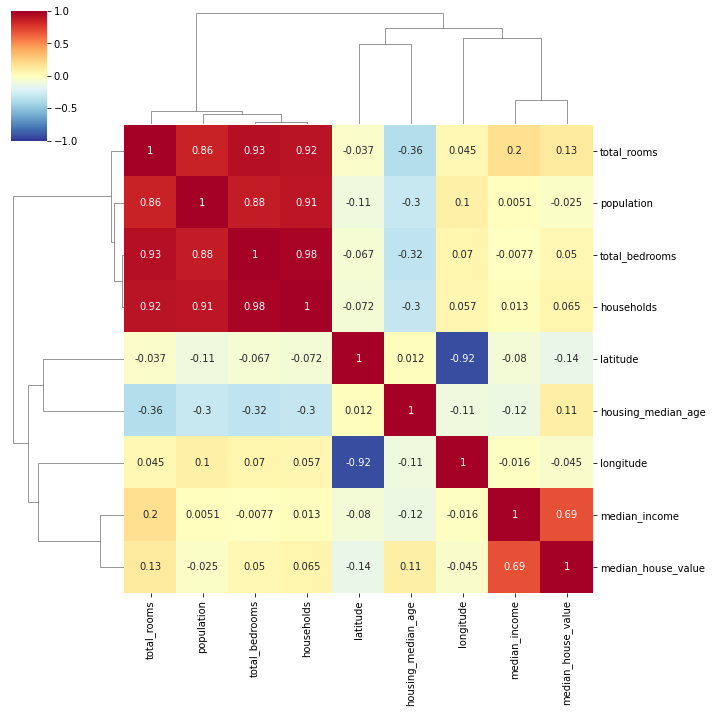

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.clustermap(corr_matrix, annot = True, cmap = 'RdYlBu_r', vmin = -1, vmax = 1)

In [ ]:
from sklearn import metrics

def silhouette_score(estimator, X):
    clusters = estimator.fit_predict(X)
    # if clusters.labels_ < 2:
    #     return 0
    score = metrics.silhouette_score(X, clusters)
    return score

In [ ]:
def combine_data_features(data, feature_combination):
  
  data = data[feature_combination]
  return data

In [ ]:
from sklearn.preprocessing import LabelEncoder
from category_encoders import TargetEncoder
import category_encoders

pd.set_option('mode.chained_assignment',  None) # <==== 경고를 끈다

def encode_data(data, house_price, encoder_type):
  if encoder_type == 'LabelEncoder':
    encoder = LabelEncoder()
    encoder.fit(data['ocean_proximity'])
    data['ocean_proximity'] = encoder.transform(data['ocean_proximity'])
  
  elif encoder_type == 'OneHotEncoder':
    data = pd.get_dummies(data, columns = ['ocean_proximity'], drop_first = True)

  elif encoder_type == 'TargetEncoder':
    encoder = TargetEncoder()
    data['ocean_proximity_encoded'] = encoder.fit_transform(data['ocean_proximity'], house_price)
    data.drop('ocean_proximity', axis = 1, inplace = True)
  
  return data

In [ ]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler

def scale_data(data, scaler_type):
  if scaler_type == 'StandardScaler':
    scaler = StandardScaler()
  
  elif scaler_type == 'MinMaxScaler':
    scaler = MinMaxScaler()

  elif scaler_type == 'RobustScaler':
    scaler = RobustScaler()

  scaler.fit(data)
  data = scaler.transform(data)

  return data

In [ ]:
# label_standard_data = scale_data(encode_data(X, y, 'LabelEncoder'), 'StandardScaler')
# label_standard_tsne_data = tsne(label_standard_data)
# label_minmax_data = scale_data(encode_data(X, y, 'LabelEncoder'), 'MinMaxScaler')
# label_minmax_tsne_data = tsne(label_standard_data)
# label_robust_data = scale_data(encode_data(X, y, 'LabelEncoder'), 'RobustScaler')
# label_robust_tsne_data = tsne(label_standard_data)
# onehot_standard_data = scale_data(encode_data(X, y, 'OneHotEncoder'), 'StandardScaler')
# onehot_standard_tsne_data = tsne(label_standard_data)
# onehot_minmax_data = scale_data(encode_data(X, y, 'OneHotEncoder'), 'MinMaxScaler')
# onehot_minmax_tsne_data = tsne(label_standard_data)
# onehot_robust_data = scale_data(encode_data(X, y, 'OneHotEncoder'), 'RobustScaler')
# onehot_robust_tsne_data = tsne(label_standard_data)
# target_standard_data = scale_data(encode_data(X, y, 'TargetEncoder'), 'StandardScaler')
# target_standard_tsne_data = tsne(label_standard_data)
# target_minmax_data = scale_data(encode_data(X, y, 'TargetEncoder'), 'MinMaxScaler')
# target_minmax_tsne_data = tsne(label_standard_data)
# target_robust_data = scale_data(encode_data(X, y, 'TargetEncoder'), 'RobustScaler')
# target_robust_tsne_data = tsne(label_standard_data)

In [ ]:
# def encode_scale_tsne_data(encoder, scaler, tsneonoff):
#     if encoder == 'LabelEncoder' and scaler == 'StandardScaler':
#         if tsneonoff:
#             return label_standard_tsne_data
#         else: 
#             return label_standard_data
#     elif encoder == 'LabelEncoder' and scaler == 'MinMaxScaler':
#         if tsneonoff:
#             return label_minmax_tsne_data
#         else: 
#             return label_minmax_data
#     elif encoder == 'LabelEncoder' and scaler == 'RobustScaler':
#         if tsneonoff:
#             return label_robust_tsne_data
#         else: 
#             return label_robust_data
#     elif encoder == 'OneHotEncoder' and scaler == 'StandardScaler':
#         if tsneonoff:
#             return onehot_standard_tsne_data
#         else: 
#             return onehot_standard_data
#     elif encoder == 'OneHotEncoder' and scaler == 'MinMaxScaler':
#         if tsneonoff:
#             return onehot_minmax_tsne_data
#         else: 
#             return onehot_minmax_data
#     elif encoder == 'OneHotEncoder' and scaler == 'RobustScaler':
#         if tsneonoff:
#             return onehot_robust_tsne_data
#         else: 
#             return onehot_robust_data
#     elif encoder == 'TargetEncoder' and scaler == 'StandardScaler':
#         if tsneonoff:
#             return target_standard_tsne_data
#         else: 
#             return target_standard_data
#     elif encoder == 'TargetEncoder' and scaler == 'MinMaxScaler':
#         if tsneonoff:
#             return target_minmax_tsne_data
#         else: 
#             return target_minmax_data
#     elif encoder == 'TargetEncoder' and scaler == 'RobustScaler':
#         if tsneonoff:
#             return target_robust_tsne_data
#         else: 
#             return target_robust_data

In [ ]:
#####################################################################################3
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.mixture import GaussianMixture
from pyclustering.cluster.clarans import clarans
from pyclustering.utils import timedcall

def cluster_data(X, model, hyper_parameter_dict, n_cluster, quality_measure):
  if model == 'KMeans':
    clustering_algorithm = KMeans()
    gs = GridSearchCV(clustering_algorithm, param_grid = hyper_parameter_dict, scoring=quality_measure, refit=True).fit(X)

    m = KMeans(n_clusters = n_cluster, random_state = gs.best_params_['random_state']).fit(X)
    print("Best params : ", gs.best_params_)
    print("inertia: ", m.inertia_)


  elif model == "DBSCAN":
    clustering_algorithm = DBSCAN()
    gs = GridSearchCV(clustering_algorithm, param_grid = hyper_parameter_dict, scoring=quality_measure, refit=True).fit(X)
    print("Best params : ", gs.best_params_)
    m = DBSCAN(eps = gs.best_params_['eps'], min_samples = gs.best_params_['min_samples']).fit(X)
    
  elif model == 'EM':
    clustering_algorithm = GaussianMixture()
    gs = GridSearchCV(clustering_algorithm, param_grid = hyper_parameter_dict, scoring=quality_measure, refit=True).fit(X)
    print("Best params : ", gs.best_params_)
    m = GaussianMixture(n_components= n_cluster, random_state=gs.best_params_['random_state']).fit(X)

    gmm_labels = m.fit_predict(X)
    

  elif model == 'CLARANS':
    clarans_instance = clarans(X, n_cluster, 3, 5)
    (ticks, result) = timedcall(clarans_instance.process)
    m = clarans_instance
  return m

In [ ]:
import matplotlib.pyplot as plt
import math
def visualize(model, model_name, scaled_data, tsne_data, house_price, feature_combination):
    label = []
    if model_name == "DBSCAN": 
        label = model.labels_
    elif model_name == 'CLARANS':
        clusters = model.get_clusters()
        # print(clusters)
        label = [0 for i in range(len(scaled_data))]
        c_num = 0
        for cluster in clusters:
            for l in cluster:
                label[l] = c_num
            c_num += 1
        # medoids = model.get_medoids()
        # ### visualize
        # vis = cluster_visualizer_multidim()
        # vis.append_clusters(clusters, scaled_data, marker = "*", markersize = 5)
        # vis.show(max_row_size = 3)
    else:
        label = model.predict(scaled_data)
    #Getting unique labels
    u_labels, l_counts = np.unique(label, return_counts=True)
    print("Count labels: ", len(u_labels))
    score = metrics.silhouette_score(scaled_data, label)
    print("Silhouette score: ", score)
    index_num = 1

    num = 0
    for i in range(len(feature_combination)):
        num += i
    if num < 1:
        num = 1
    # #plotting the results:
    # fig = plt.figure(figsize=(36, math.ceil(num/6)*6))
    # for a in range(len(feature_combination)):
    #     for b in range(a+1, len(feature_combination)):
    #         ax = fig.add_subplot(math.ceil(num/6), 6, index_num)
    #         index_num += 1
    #         for i in u_labels:
    #             ax.scatter(scaled_data[label == i , a] , scaled_data[label == i , b] , label = i, s=3)
    #         ax.set_xlabel(feature_combination[a])
    #         ax.set_ylabel(feature_combination[b])
    # plt.show()

    # print("\nCompare with house price")
    # index_num = 1
    # fig = plt.figure(figsize=(36, math.ceil(num/6)*6))
    # for a in range(len(feature_combination)):
    #     ax = fig.add_subplot(math.ceil(num/6), 6, index_num)
    #     index_num += 1
    #     for i in u_labels:
    #         ax.scatter(house_price[label == i] , scaled_data[label == i , a] , label = i, s=3)
    #     ax.set_xlabel('house price')
    #     ax.set_ylabel(feature_combination[a])
    # plt.show()

    fig = plt.figure(figsize=(18, 6))
    fig.tight_layout()
    ax = fig.add_subplot(131, projection='3d')
    for i in u_labels:
        ax.scatter(tsne_data[label == i , 0] , tsne_data[label == i , 1], house_price[label == i] , label = i, s=3)
    ax.set_title('Visualize by t-SNE')
    ax.set_xlabel('tsne1')
    ax.set_ylabel('tsne2')
    
    ax = fig.add_subplot(132)
    for i in u_labels:
        ax.scatter(tsne_data[label == i , 0] , tsne_data[label == i , 1], label = i, s=3)
    ax.set_title('Visualize by t-SNE')
    ax.set_xlabel('tsne1')
    ax.set_ylabel('tsne2')

    ax = fig.add_subplot(133)
    ax.bar(u_labels, l_counts)
    ax.set_xlabel('label')
    ax.set_ylabel('count')
    plt.show()




In [ ]:
def preprocess(dataset, encoder_list, scaler_list, feature_combinations):
    preprocessed_data = [[[dataset for _ in range(len(encoder_list))] for _ in range(len(scaler_list))] for _ in range(len(feature_combinations))]
    preprocessed_tsne_data = [[[dataset for _ in range(len(encoder_list))] for _ in range(len(scaler_list))] for _ in range(len(feature_combinations))]
    feature_data = dataset.iloc[:, [0, 1, 2, 3, 4, 5, 6, 7, 9]]
    house_price = dataset.iloc[:, 8] # target feature
    for i in range(len(encoder_list)):
        for j in range(len(scaler_list)):
            for k in range(len(feature_combinations)):
                combined_data = combine_data_features(feature_data, feature_combinations[k])

                if 'ocean_proximity' in feature_combinations[k]:
                    encoded_data = encode_data(combined_data, house_price, encoder_list[i])
                else:
                    encoded_data = combined_data

                scaled_data = scale_data(encoded_data, scaler_list[j])
                preprocessed_data[i][j][k] = scaled_data
                preprocessed_tsne_data[i][j][k] = tsne(scaled_data)
    return preprocessed_data, preprocessed_tsne_data

In [ ]:
from yellowbrick.cluster import KElbowVisualizer
def AutoML(dataset, model_list, encoder_list, scaler_list, n_clusters, feature_combinations, hyper_parameter_dict, quality_measure):

  items = [model_list, encoder_list, scaler_list, n_clusters, feature_combinations]
  combinations = list(product(*items))

  preprocessed_data, preprocessed_tsne_data = preprocess(dataset, encoder_list, scaler_list, feature_combinations)

  for model, encoder, scaler, n_cluster, feature_combination in combinations:
    if model == 'DBSCAN' and n_cluster > 2:
      continue
    print("\n\n\n===================================================================")
    print("Model: ", model)
    print("Encoder: ", encoder)
    print("Scaler: ", scaler)
    print("Feature list: ", feature_combination)
    if model != 'DBSCAN': 
      print("n_cluster: ", n_cluster)

    # test with sample
    if model == 'CLARANS':
      sample_dataset = dataset.sample(n=500)
      feature_data = sample_dataset.iloc[:, [0, 1, 2, 3, 4, 5, 6, 7, 9]]
      house_price = sample_dataset.iloc[:, 8] # target feature
      combined_data = combine_data_features(feature_data, feature_combination)
      if 'ocean_proximity' in feature_combination:
        encoded_data = encode_data(combined_data, house_price, encoder)
      else:
        encoded_data = combined_data
      scaled_data = scale_data(encoded_data, scaler)
    else:
      feature_data = dataset.iloc[:, [0, 1, 2, 3, 4, 5, 6, 7, 9]]
      house_price = dataset.iloc[:, 8] # target feature
      scaled_data = preprocessed_data[encoder_list.index(encoder)][scaler_list.index(scaler)][feature_combinations.index(feature_combination)]
    
    m = cluster_data(scaled_data, model, hyper_parameter_dict[model], n_cluster, quality_measure)

    if model == 'CLARANS':
      tsne_data = tsne(scaled_data)
    else:
      tsne_data = preprocessed_tsne_data[encoder_list.index(encoder)][scaler_list.index(scaler)][feature_combinations.index(feature_combination)]

    visualize(m, model, scaled_data, tsne_data, house_price, feature_combination)

    # if model != 'CLARANS' and n_cluster == 2 :
    #   visualizer = KElbowVisualizer(m, k=(1,10))
    #   visualizer.fit(scaled_data)






Model:  KMeans
Encoder:  LabelEncoder
Scaler:  StandardScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  140489.5665763122
Count labels:  2
Silhouette score:  0.3927036912683831


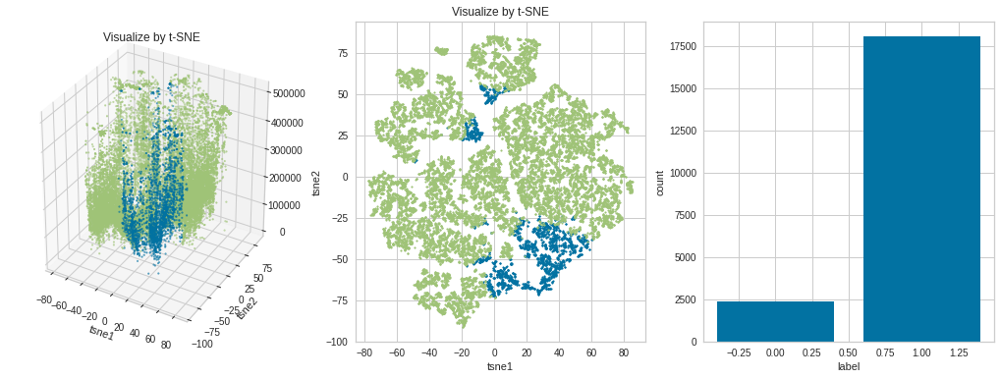




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  2
Best params :  {'random_state': 2}
inertia:  67847.22872431541
Count labels:  2
Silhouette score:  0.5063515570915781


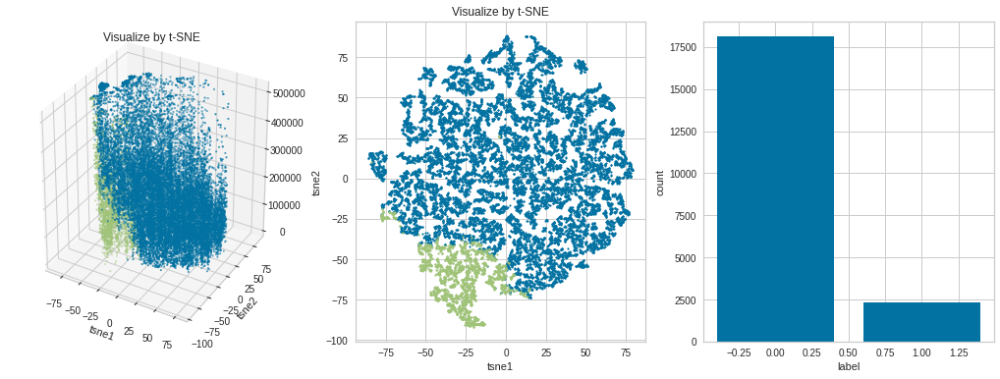




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  43170.93603437653
Count labels:  2
Silhouette score:  0.32415963974988227


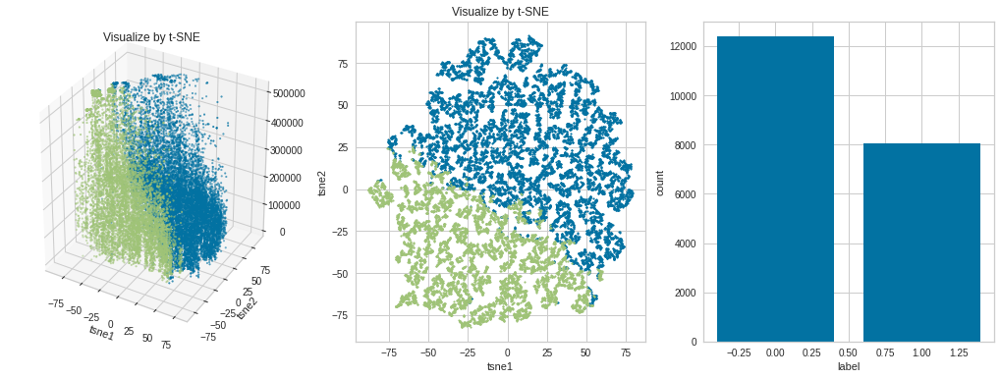




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  StandardScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  94591.6357822638
Count labels:  4
Silhouette score:  0.2775364376624531


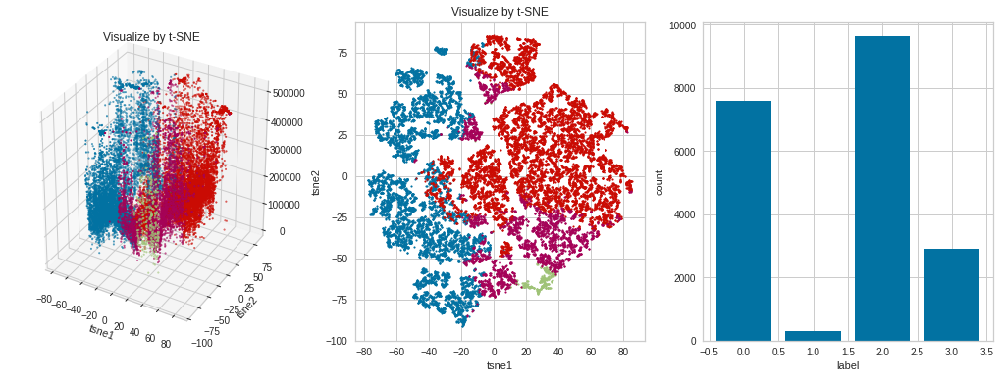




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  4
Best params :  {'random_state': 2}
inertia:  43822.61775953201
Count labels:  4
Silhouette score:  0.2997164606474733


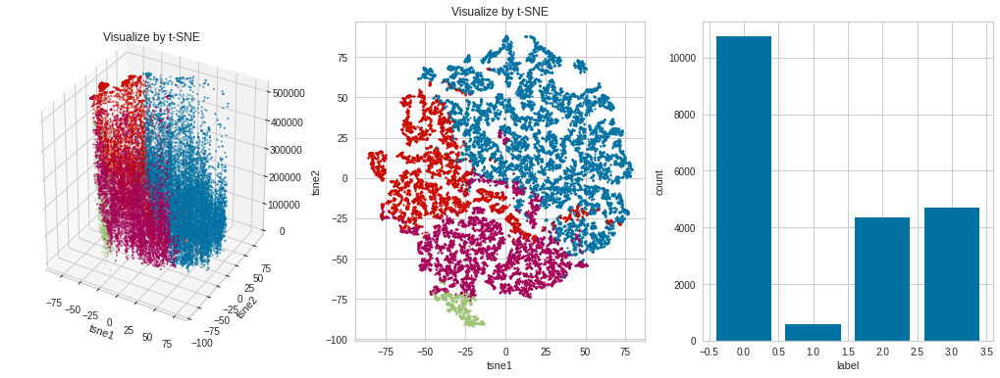




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  26094.58103072478
Count labels:  4
Silhouette score:  0.326915829666588


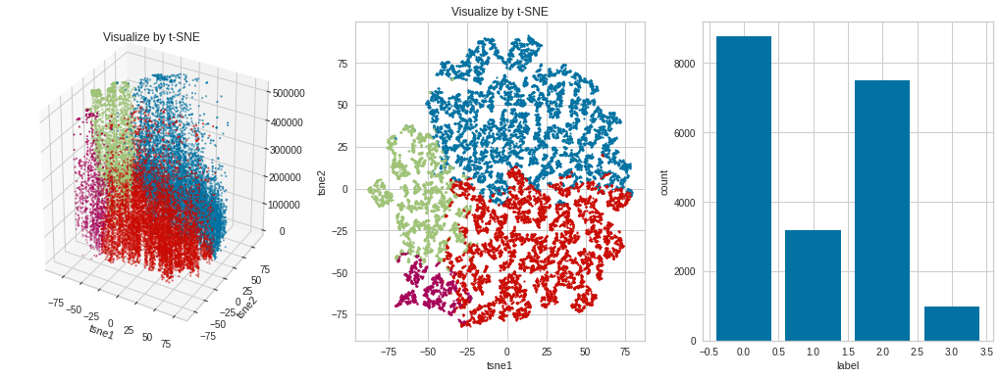




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  StandardScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  76706.70249860823
Count labels:  6
Silhouette score:  0.2811289341719952


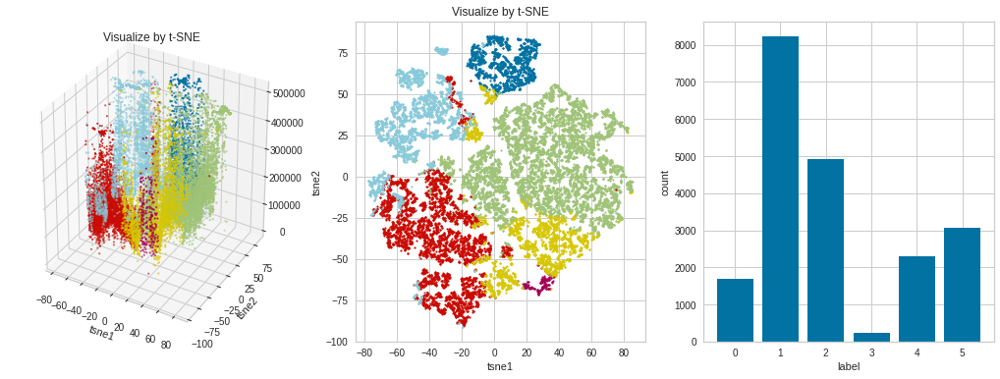




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  6
Best params :  {'random_state': 2}
inertia:  31681.66962541666
Count labels:  6
Silhouette score:  0.2755152514382991


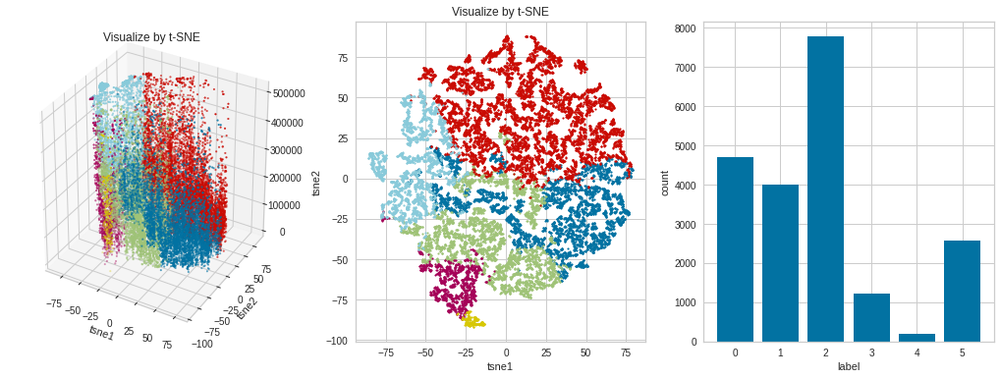




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  20089.990229716066
Count labels:  6
Silhouette score:  0.27633602688255005


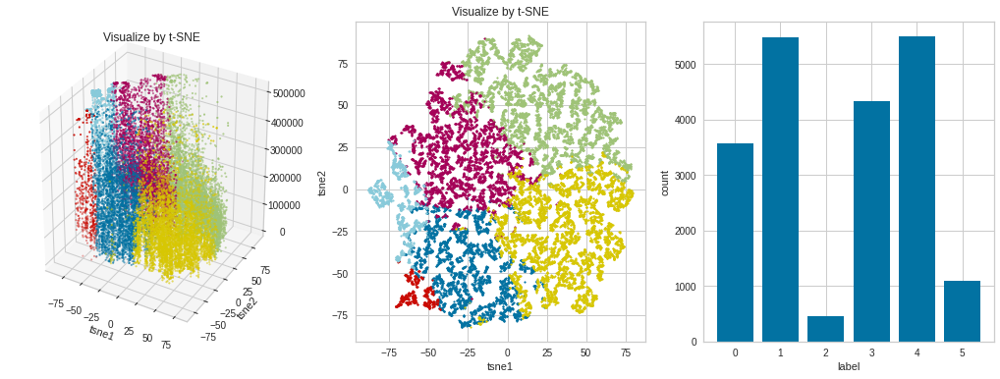




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  StandardScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  64814.22456802496
Count labels:  8
Silhouette score:  0.2501548358999188


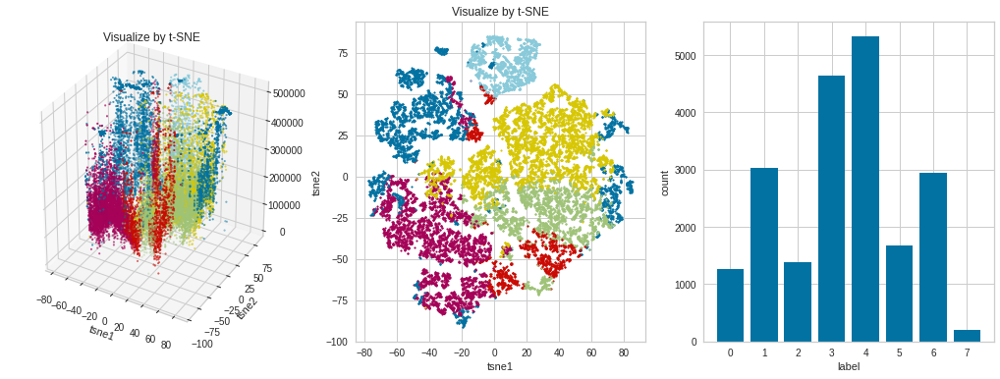




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  8
Best params :  {'random_state': 2}
inertia:  26691.694126957096
Count labels:  8
Silhouette score:  0.24810916699420546


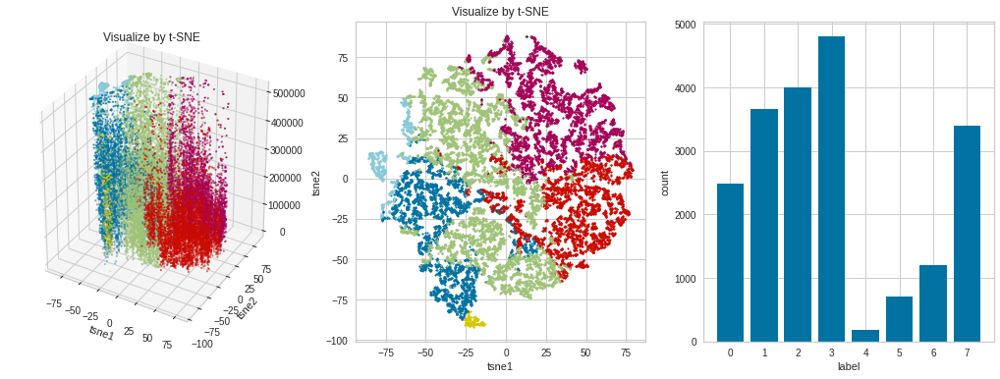




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  15830.384554433815
Count labels:  8
Silhouette score:  0.2653898371036186


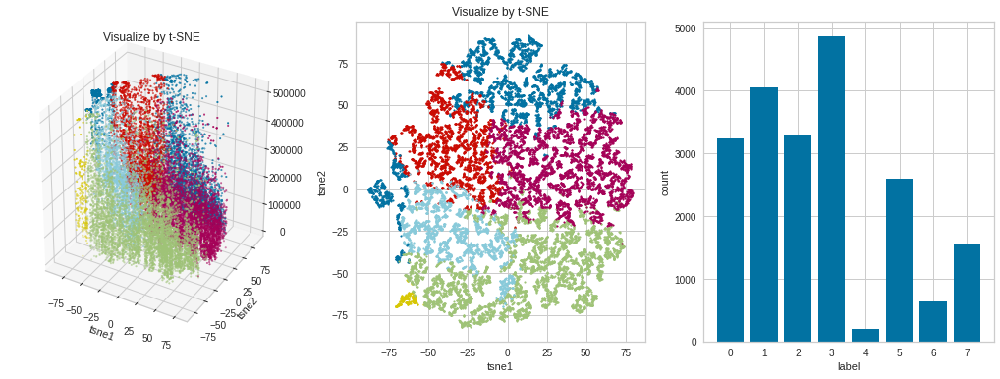




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  StandardScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  57174.80211809517
Count labels:  10
Silhouette score:  0.2394449459737135


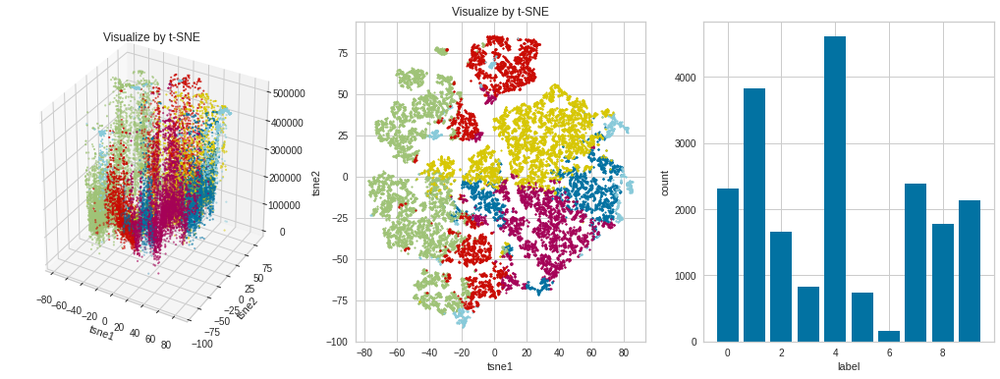




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  10
Best params :  {'random_state': 2}
inertia:  22892.90682799973
Count labels:  10
Silhouette score:  0.24288537417251432


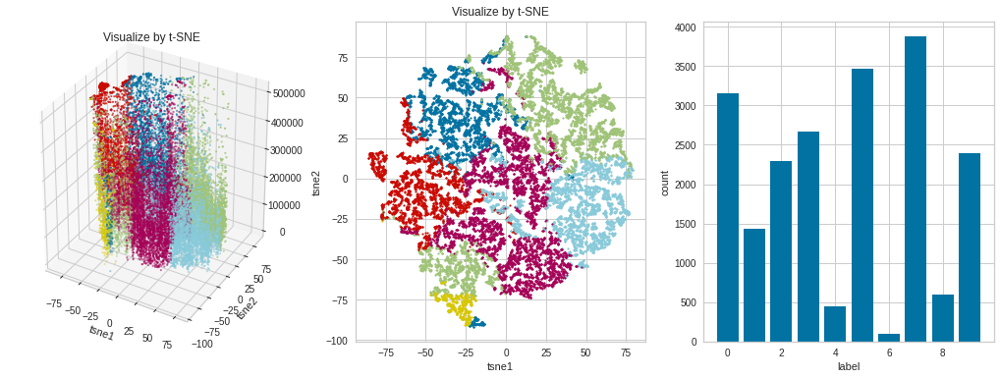




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  13619.213995308382
Count labels:  10
Silhouette score:  0.26437229145031965


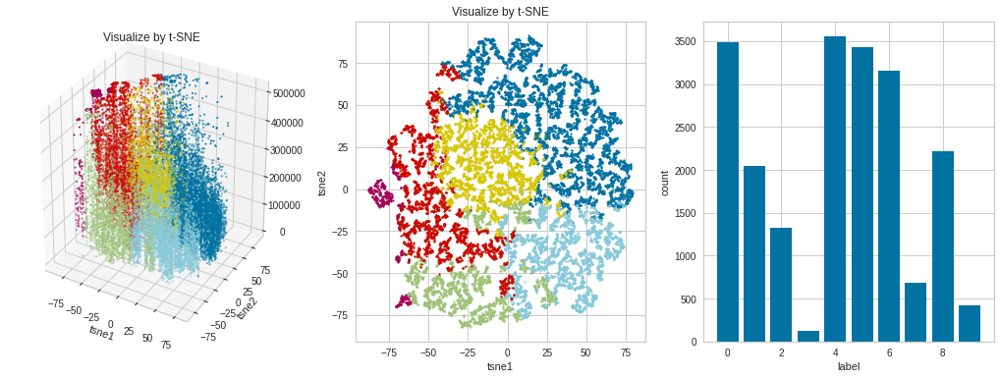




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  MinMaxScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  3874.1409843477663
Count labels:  2
Silhouette score:  0.43256809655514894


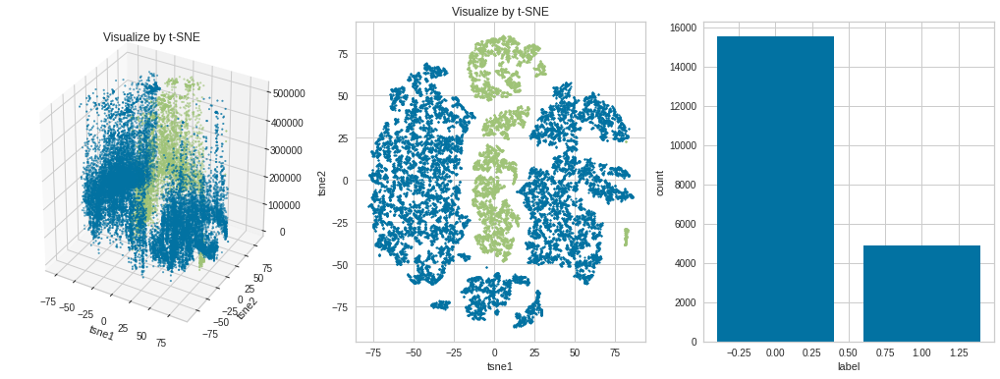




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  927.8707112859477
Count labels:  2
Silhouette score:  0.4266312746662995


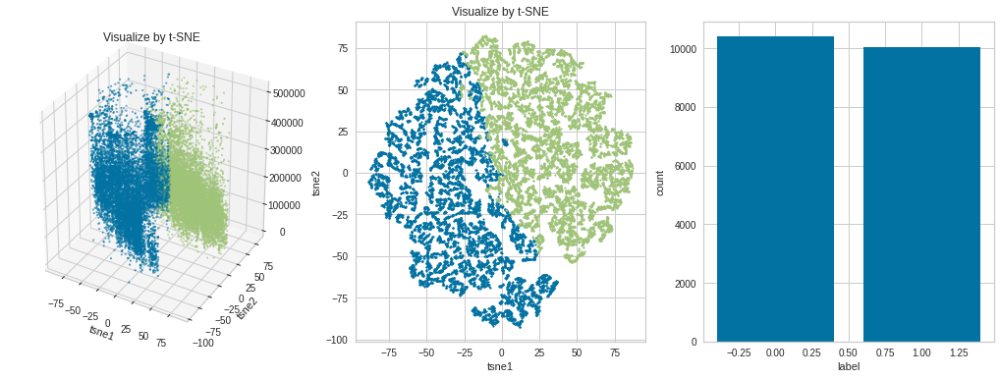




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  773.2506441927096
Count labels:  2
Silhouette score:  0.4554699975357798


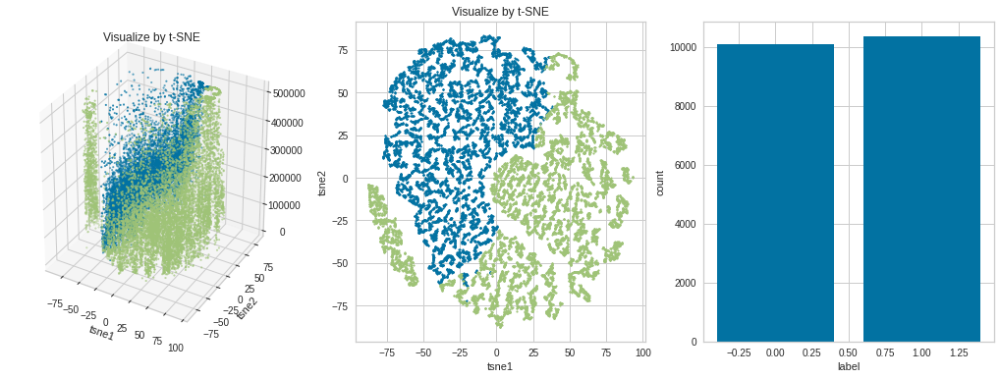




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  MinMaxScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  2200.2107886715203
Count labels:  4
Silhouette score:  0.40904774088455437


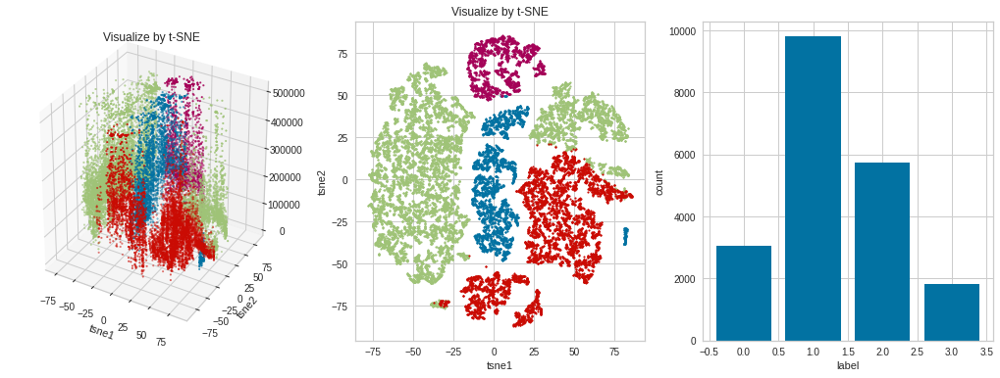




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  619.9624142359013
Count labels:  4
Silhouette score:  0.33685873057211907


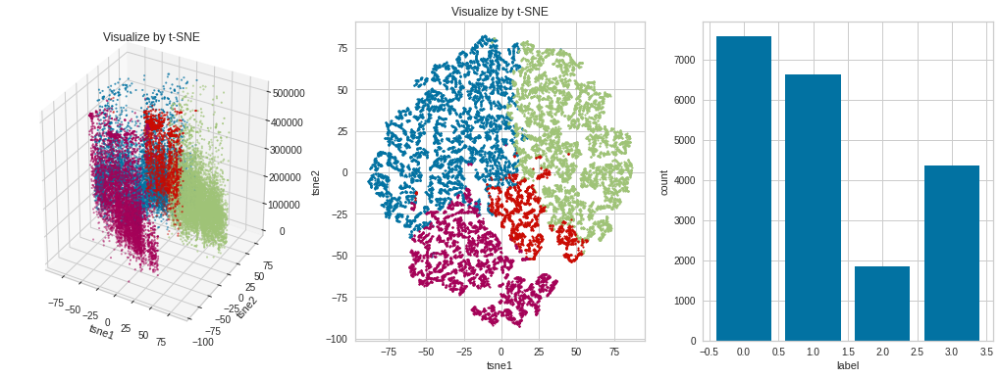




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  468.0172471264865
Count labels:  4
Silhouette score:  0.3802654258905863


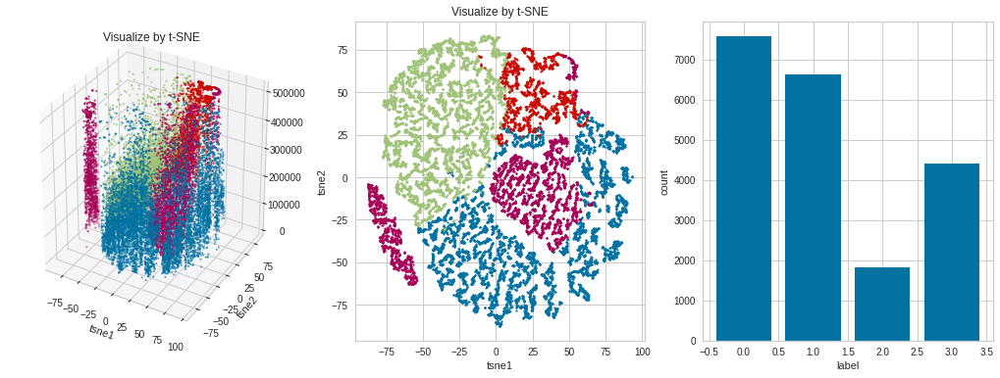




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  MinMaxScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  1574.6151006366554
Count labels:  6
Silhouette score:  0.3486158720887213


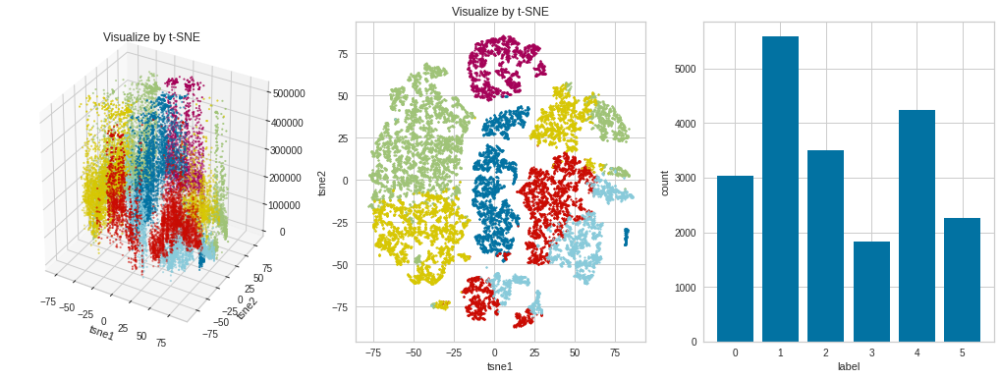




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  461.93285747324103
Count labels:  6
Silhouette score:  0.3005168194278665


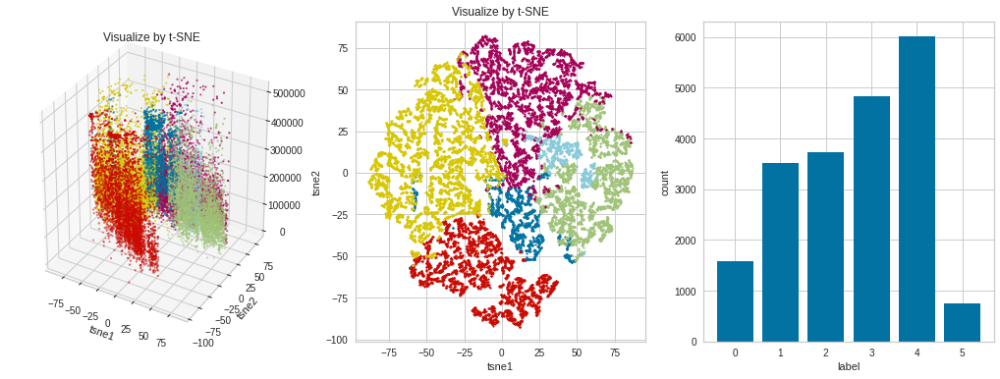




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  341.38649812116233
Count labels:  6
Silhouette score:  0.34766906403665676


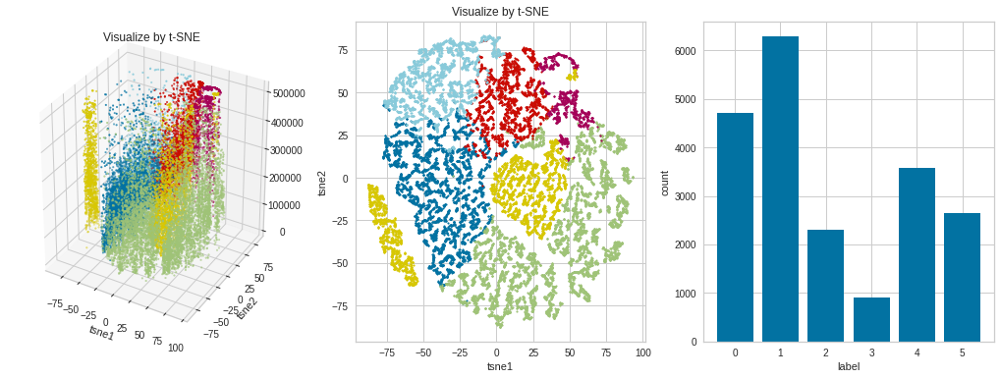




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  MinMaxScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  1351.7859720588012
Count labels:  8
Silhouette score:  0.2806535938742133


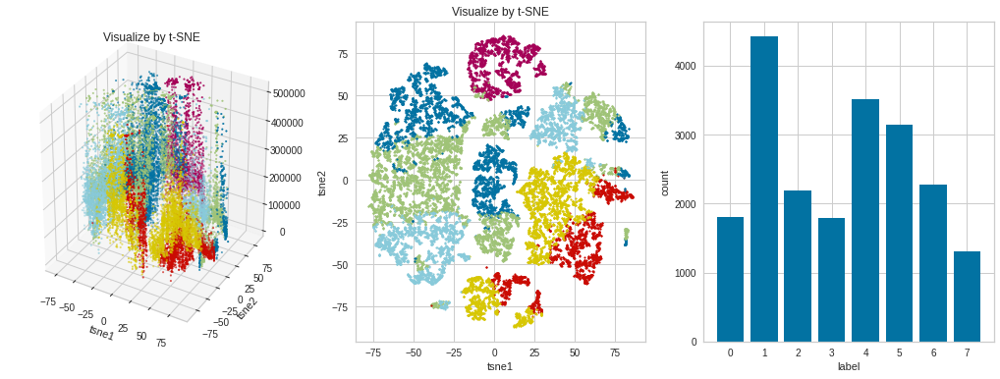




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  378.0809650956913
Count labels:  8
Silhouette score:  0.2825956338378383


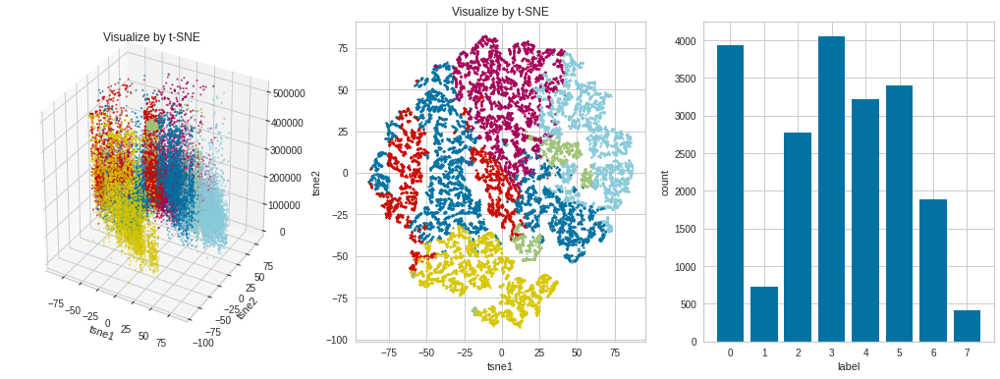




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  269.98739210703775
Count labels:  8
Silhouette score:  0.32162247450988757


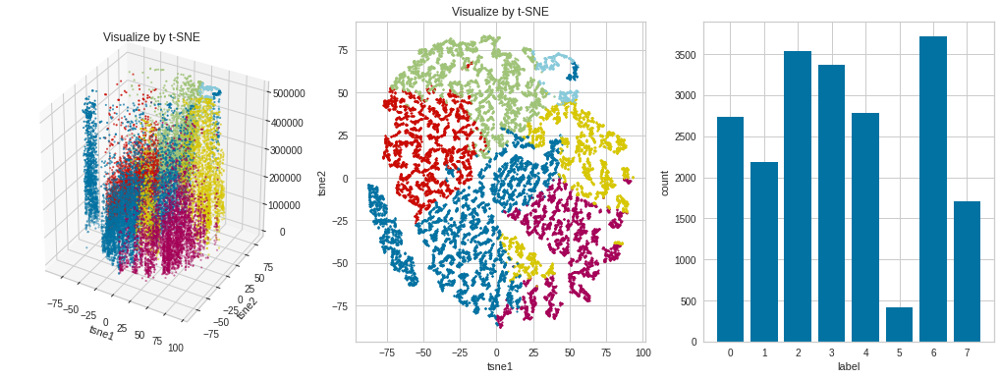




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  MinMaxScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  1211.1570007777282
Count labels:  10
Silhouette score:  0.26880157643702685


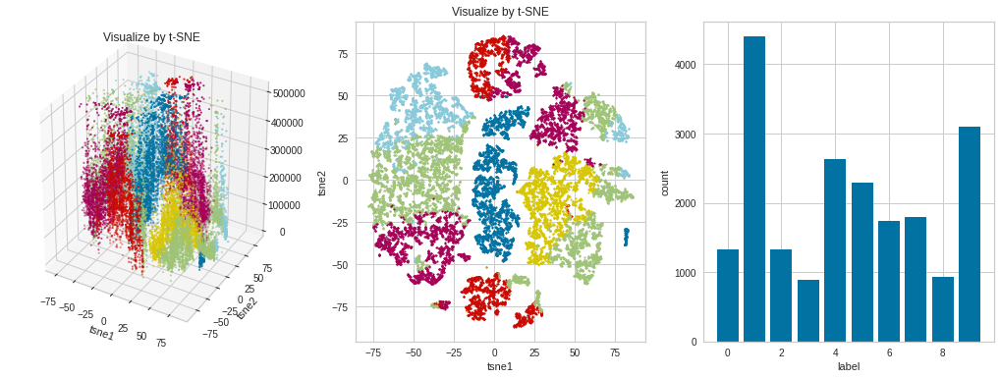




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  322.03879519443046
Count labels:  10
Silhouette score:  0.2847342610695397


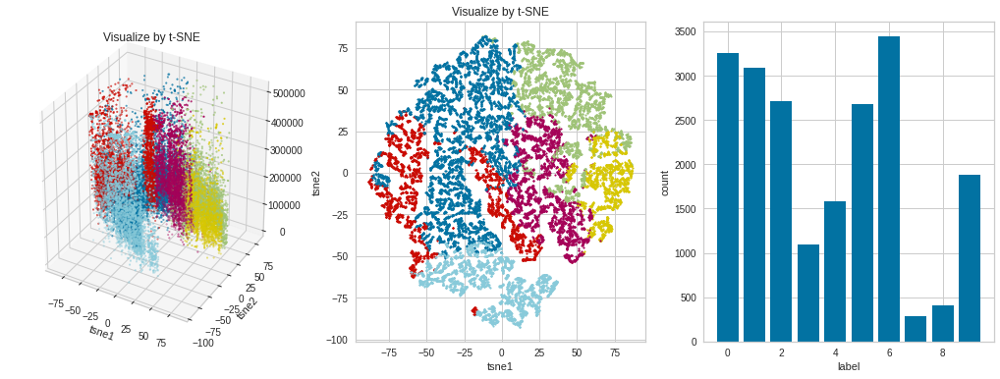




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  230.25360739299038
Count labels:  10
Silhouette score:  0.3188808202417455


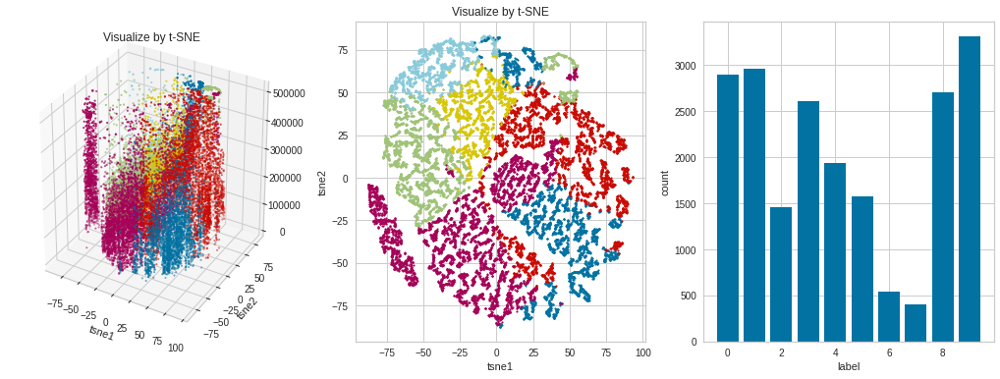




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  RobustScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  2
Best params :  {'random_state': 2}
inertia:  137372.0884276806
Count labels:  2
Silhouette score:  0.4916006200712294


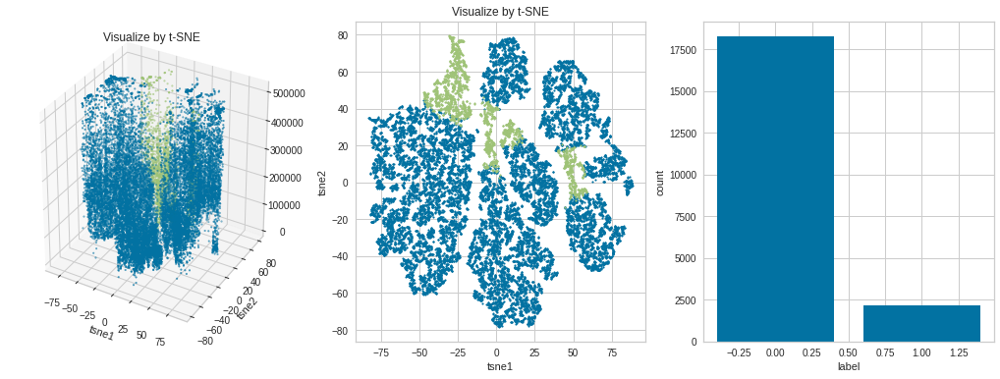




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  2
Best params :  {'random_state': 2}
inertia:  67163.88647010889
Count labels:  2
Silhouette score:  0.6000202635823454


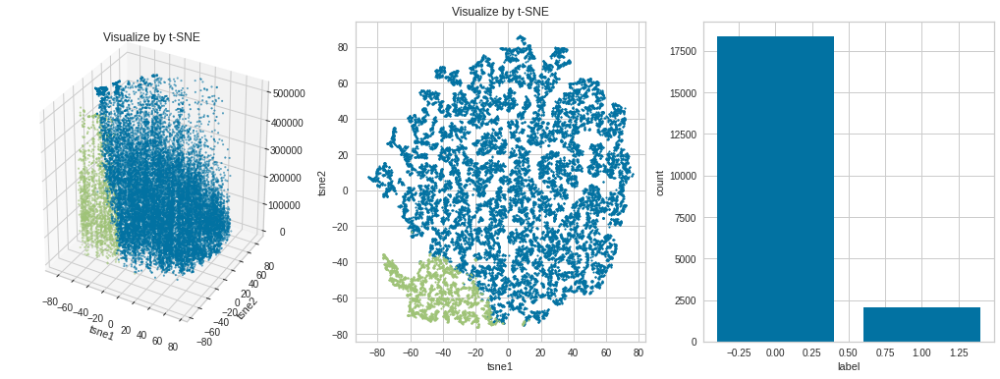




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  38957.15147267548
Count labels:  2
Silhouette score:  0.5305151704025184


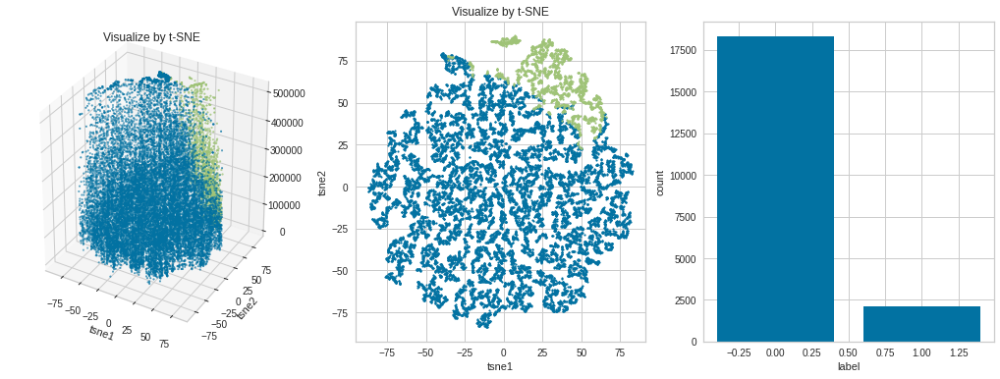




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  RobustScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  4
Best params :  {'random_state': 2}
inertia:  83128.3703717957
Count labels:  4
Silhouette score:  0.35372016267861817


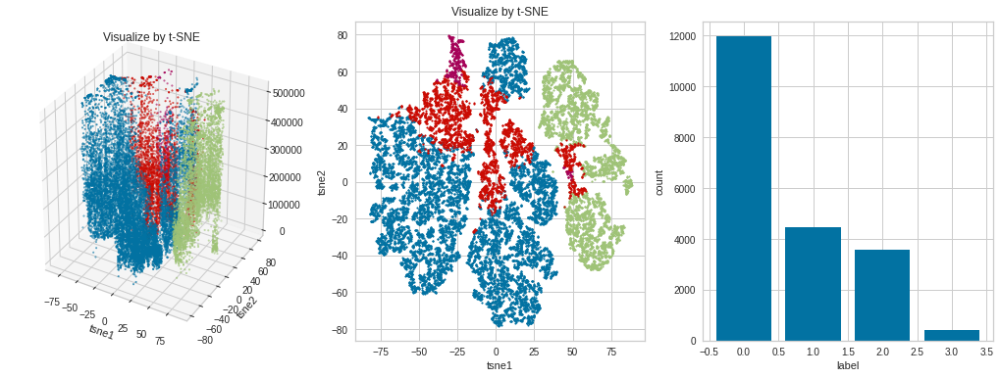




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  4
Best params :  {'random_state': 2}
inertia:  40315.81255731081
Count labels:  4
Silhouette score:  0.31223409473920877


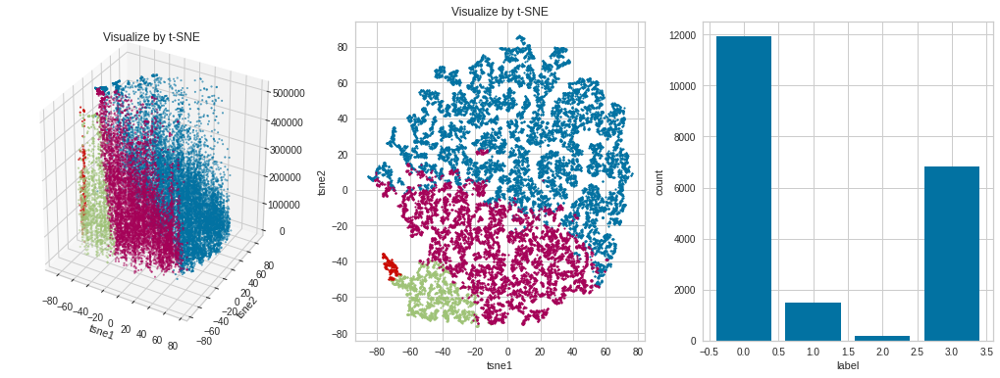




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  23824.322292396886
Count labels:  4
Silhouette score:  0.3427475968731516


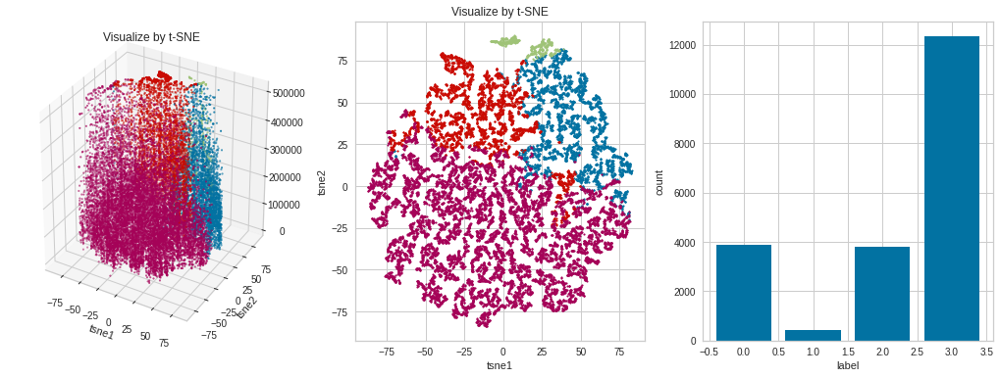




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  RobustScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  6
Best params :  {'random_state': 2}
inertia:  66985.70701194723
Count labels:  6
Silhouette score:  0.23169558422294279


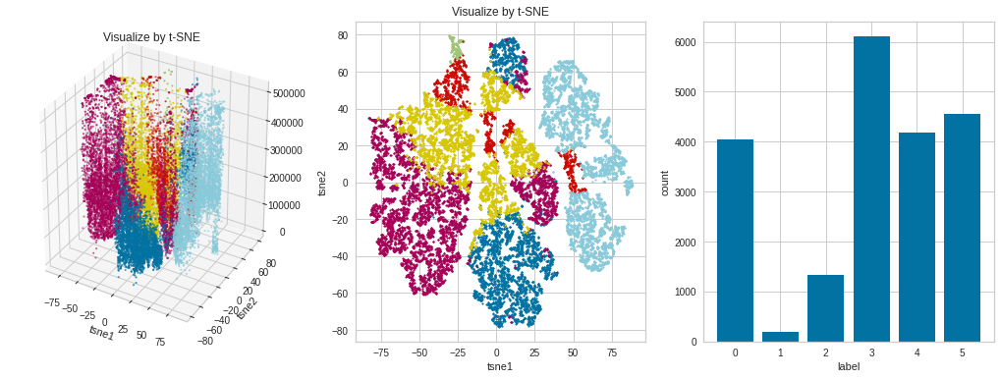




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  6
Best params :  {'random_state': 2}
inertia:  29387.62481139281
Count labels:  6
Silhouette score:  0.26824490397762435


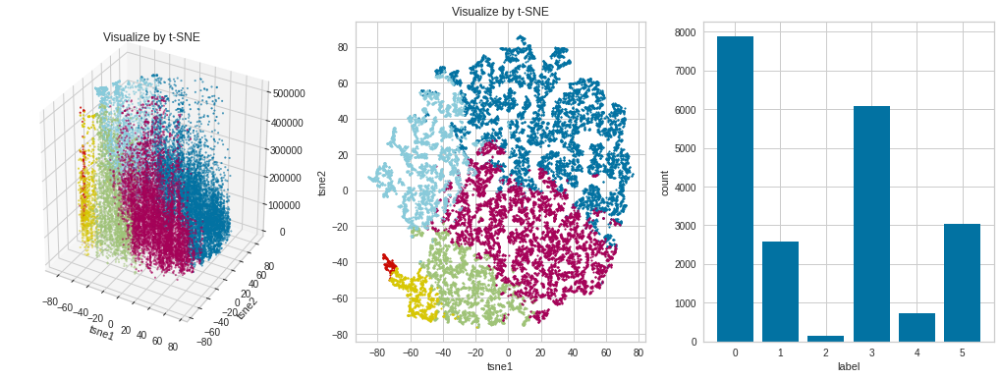




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  17446.086550505646
Count labels:  6
Silhouette score:  0.2637167507793548


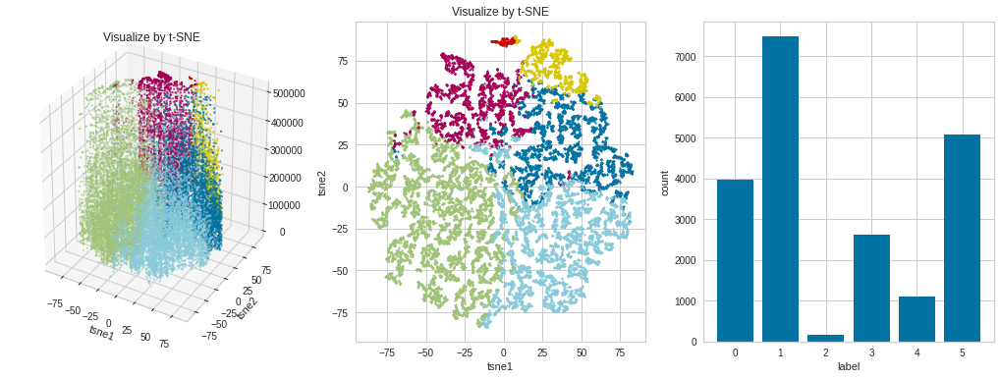




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  RobustScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  8
Best params :  {'random_state': 2}
inertia:  57328.245660588014
Count labels:  8
Silhouette score:  0.2310101819067444


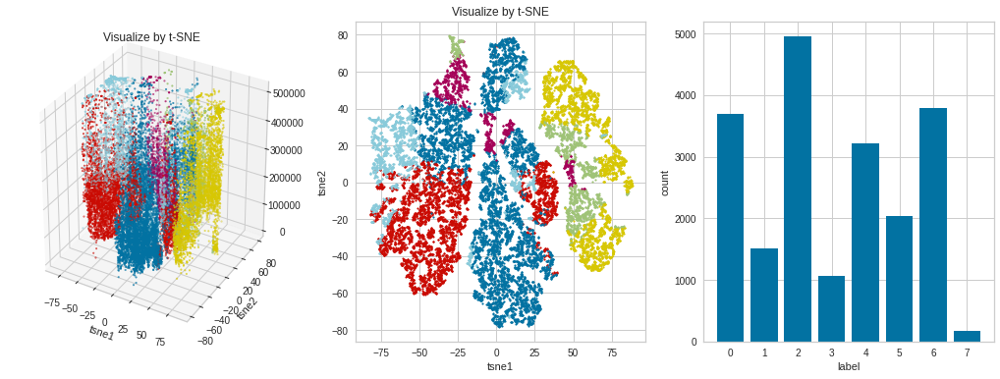




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  8
Best params :  {'random_state': 2}
inertia:  24772.327334342815
Count labels:  8
Silhouette score:  0.23727496695158615


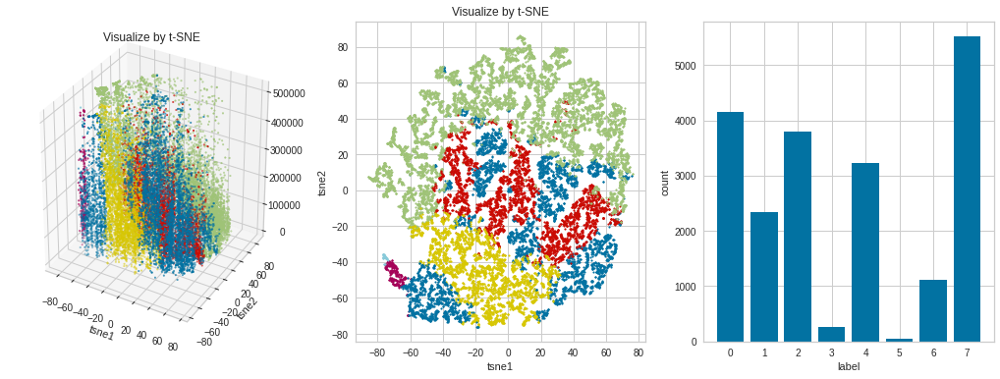




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  14066.663761913154
Count labels:  8
Silhouette score:  0.2630778593966877


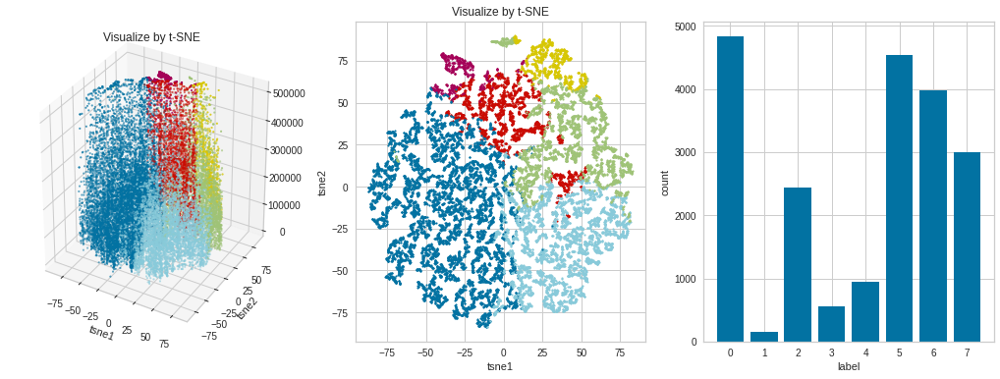




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  RobustScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  10
Best params :  {'random_state': 2}
inertia:  50703.45994576614
Count labels:  10
Silhouette score:  0.23055499724740944


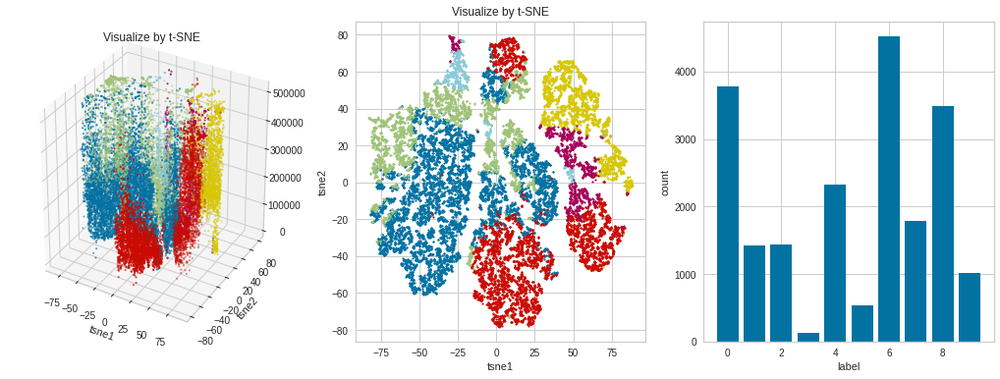




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  10
Best params :  {'random_state': 2}
inertia:  21144.11989323696
Count labels:  10
Silhouette score:  0.23285105583528667


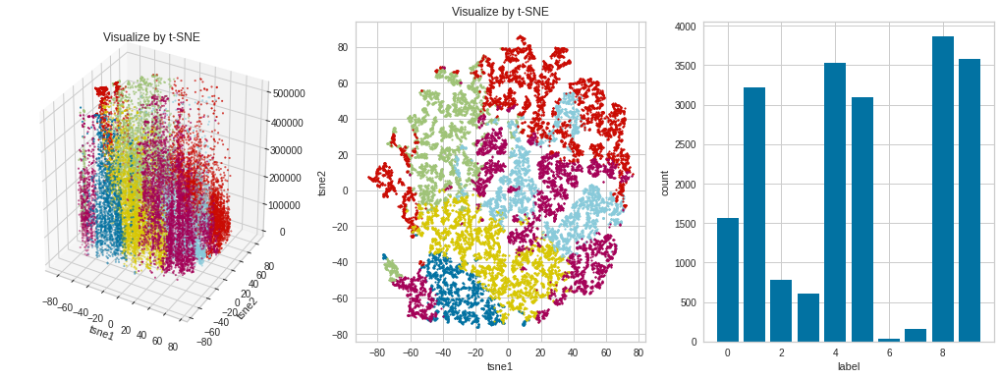




Model:  KMeans
Encoder:  LabelEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  11983.130163991525
Count labels:  10
Silhouette score:  0.2597049096262892


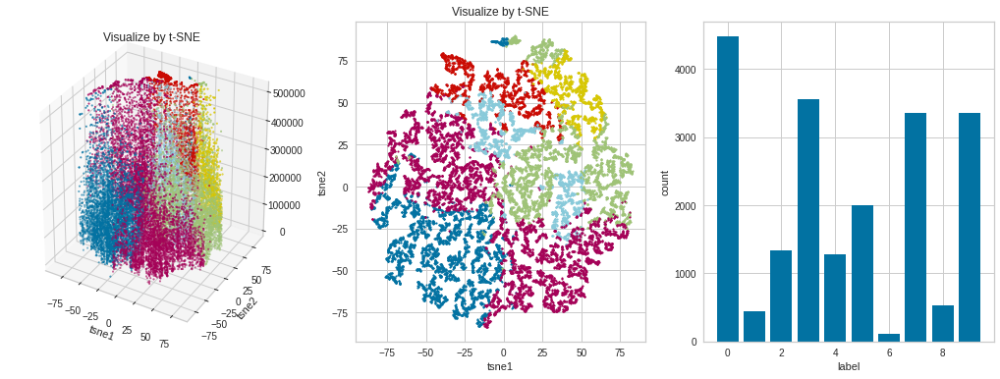




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  StandardScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  201777.7315018589
Count labels:  2
Silhouette score:  0.34594548755949533


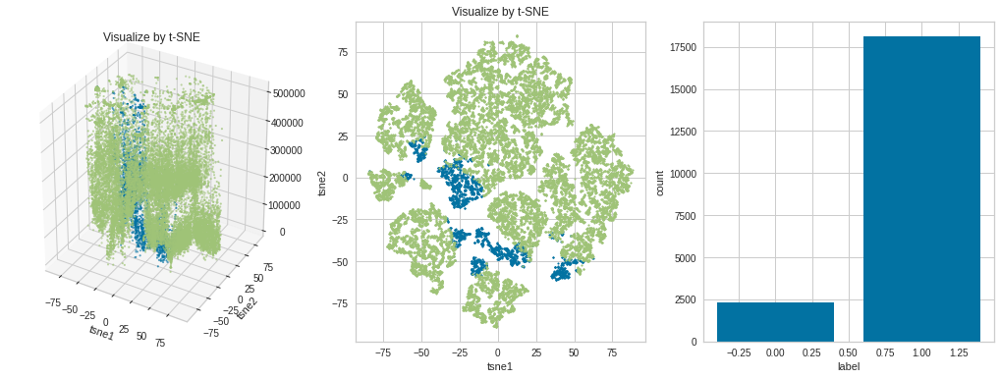




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  2
Best params :  {'random_state': 2}
inertia:  67847.22872431541
Count labels:  2
Silhouette score:  0.5063515570915781


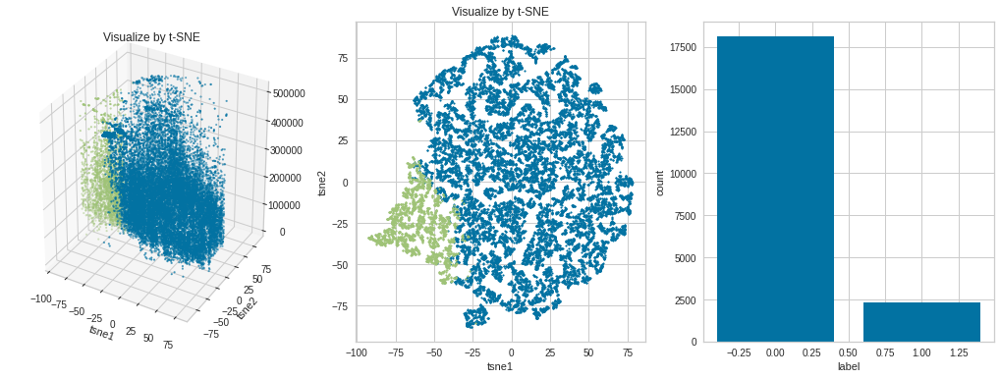




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  43170.93603437653
Count labels:  2
Silhouette score:  0.32415963974988227


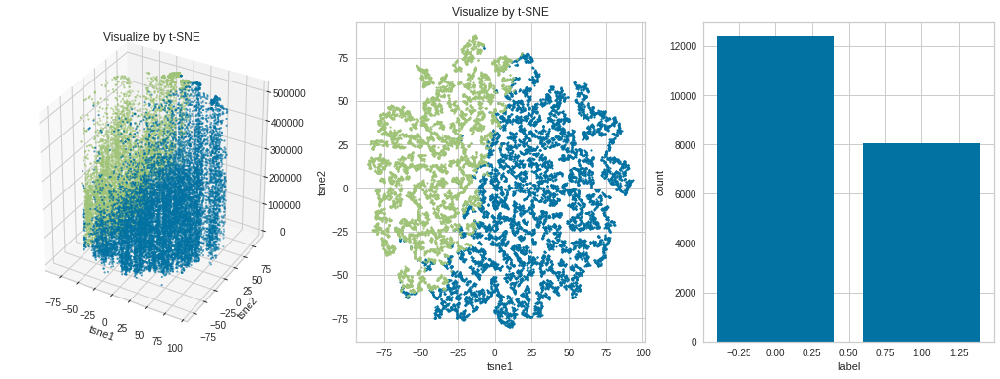




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  StandardScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  143522.38236547494
Count labels:  4
Silhouette score:  0.2830954107039344


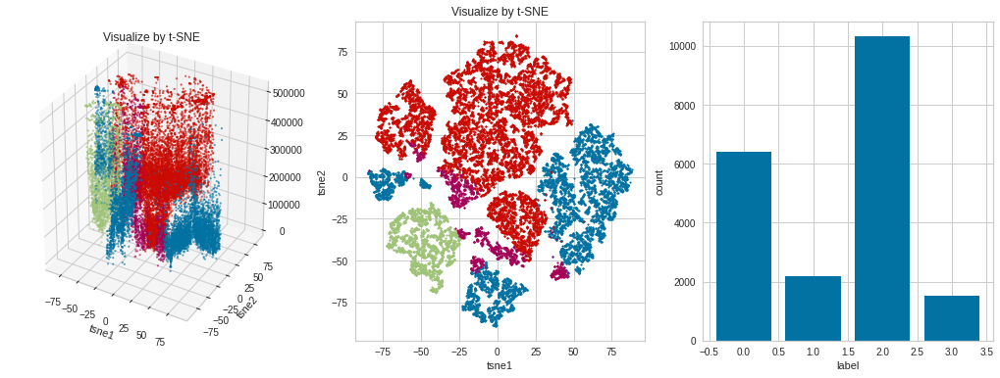




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  4
Best params :  {'random_state': 2}
inertia:  43822.61775953201
Count labels:  4
Silhouette score:  0.2997164606474733


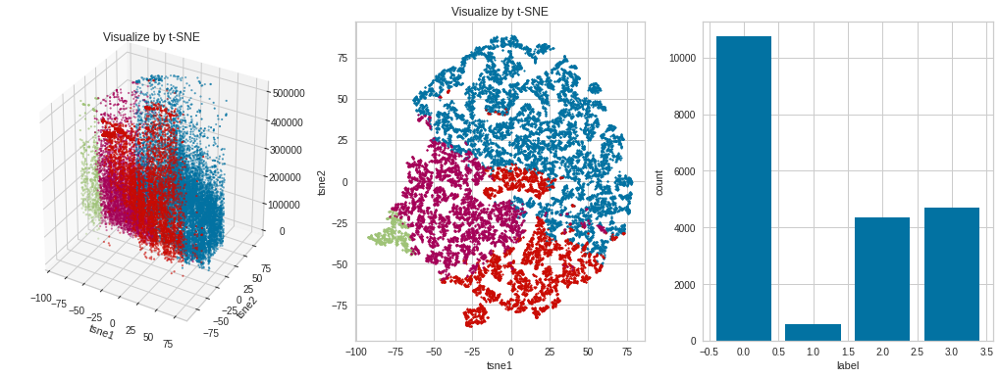




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  26094.58103072478
Count labels:  4
Silhouette score:  0.326915829666588


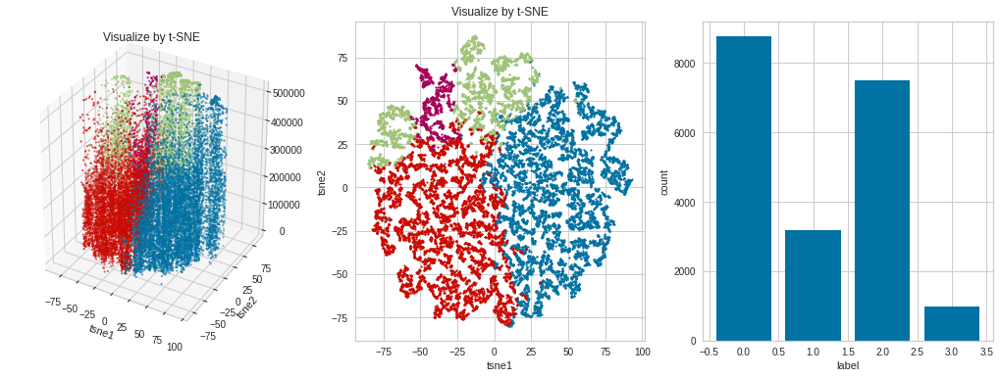




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  StandardScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  106500.32127232052
Count labels:  6
Silhouette score:  0.31017511684679144


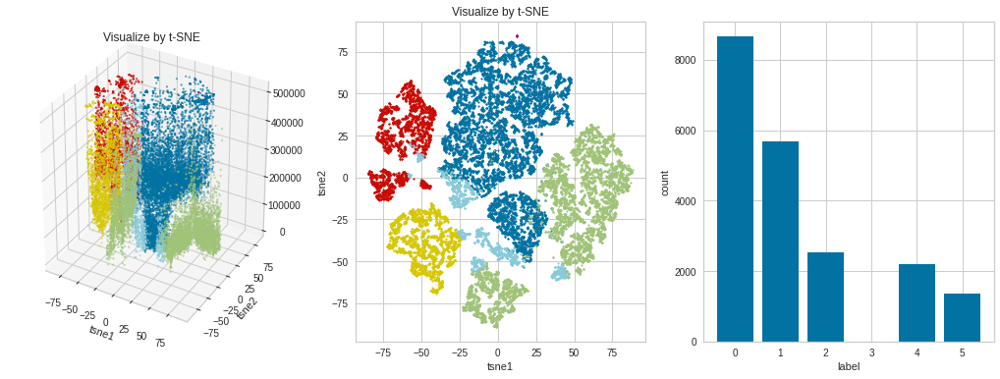




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  6
Best params :  {'random_state': 2}
inertia:  31681.66962541666
Count labels:  6
Silhouette score:  0.2755152514382991


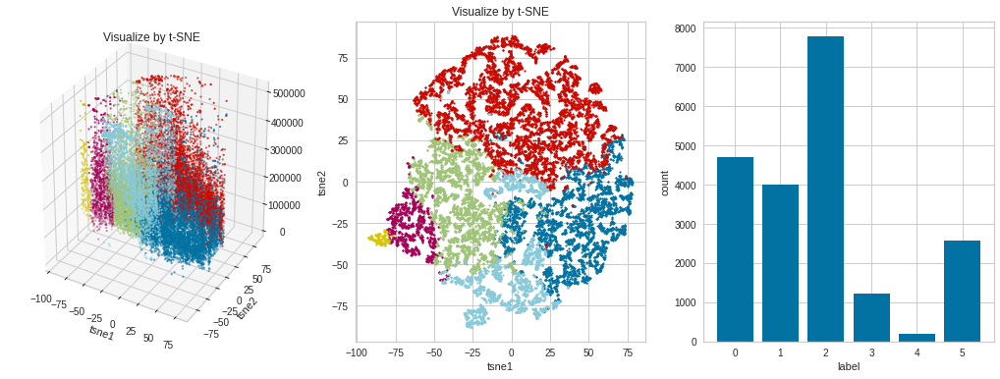




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  20089.990229716066
Count labels:  6
Silhouette score:  0.27633602688255005


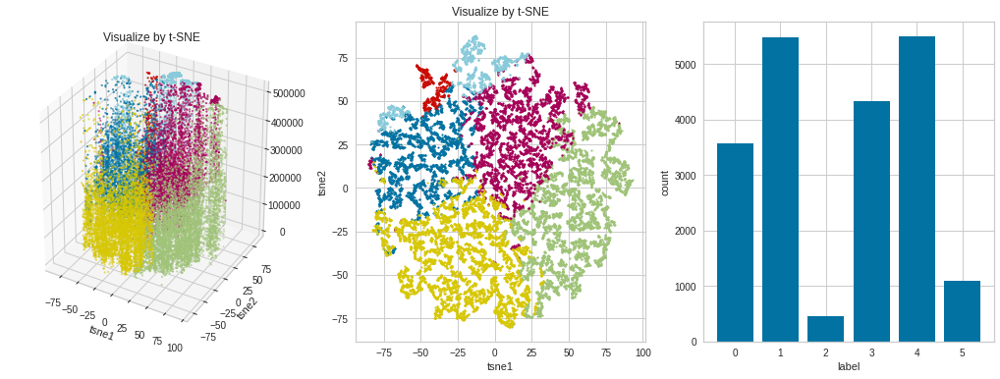




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  StandardScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  87532.81998441528
Count labels:  8
Silhouette score:  0.2781664812248462


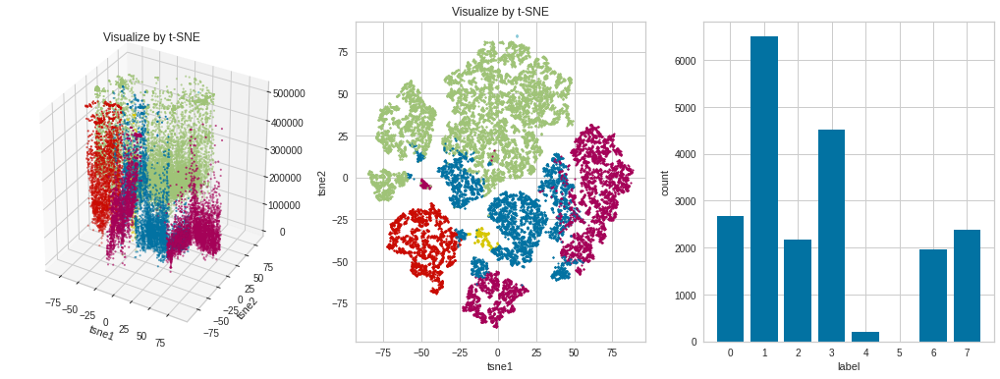




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  8
Best params :  {'random_state': 2}
inertia:  26691.694126957096
Count labels:  8
Silhouette score:  0.24810916699420546


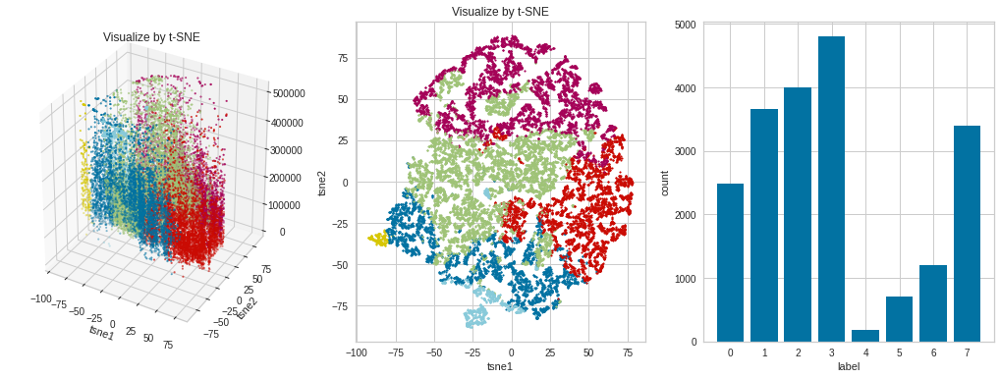




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  15830.384554433815
Count labels:  8
Silhouette score:  0.2653898371036186


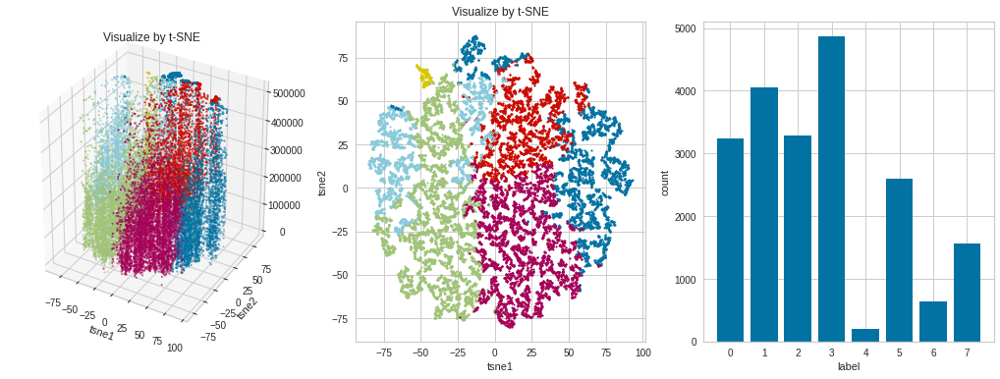




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  StandardScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  76020.05042647506
Count labels:  10
Silhouette score:  0.2908460797321889


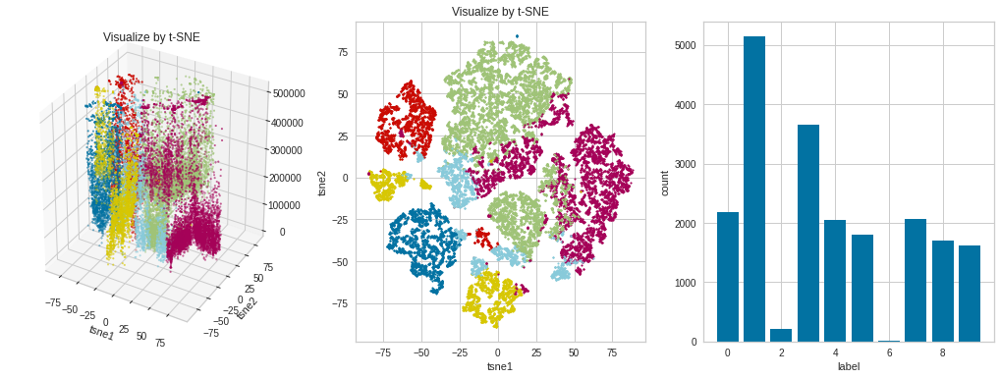




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  10
Best params :  {'random_state': 2}
inertia:  22892.90682799973
Count labels:  10
Silhouette score:  0.24288537417251432


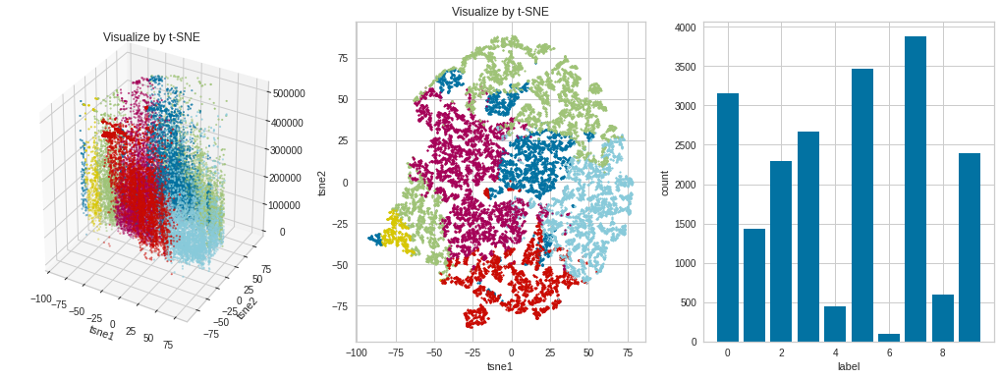




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  13619.213995308382
Count labels:  10
Silhouette score:  0.26437229145031965


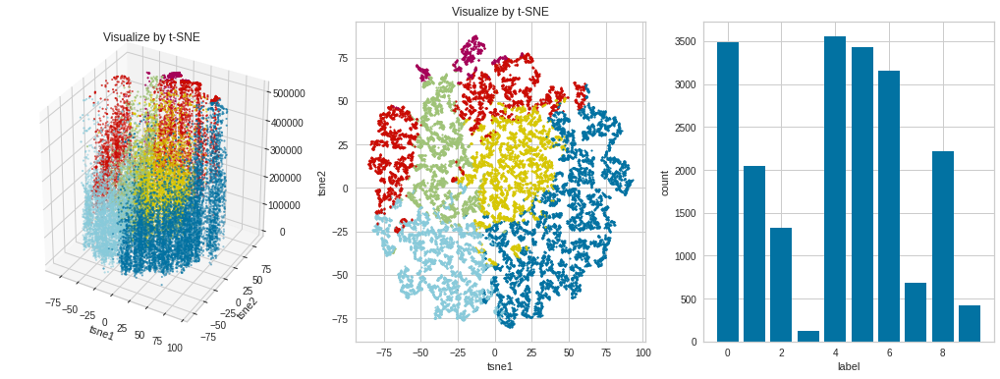




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  MinMaxScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  2
Best params :  {'random_state': 2}
inertia:  7530.240152032672
Count labels:  2
Silhouette score:  0.4279072513049073


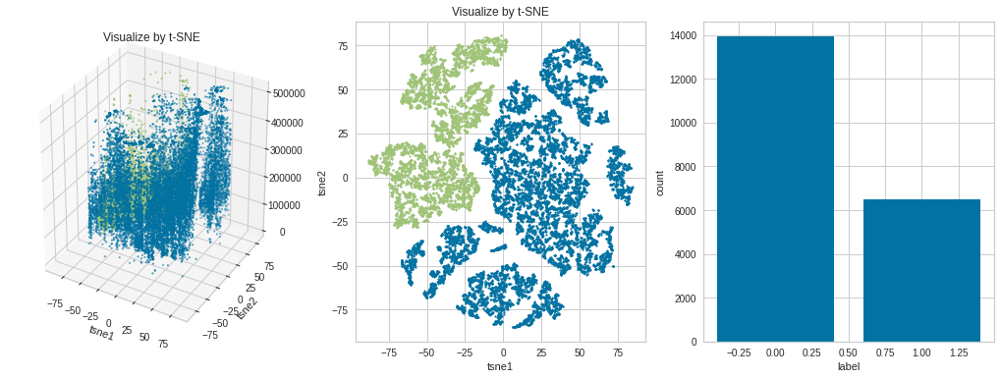




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  927.8707112859477
Count labels:  2
Silhouette score:  0.4266312746662995


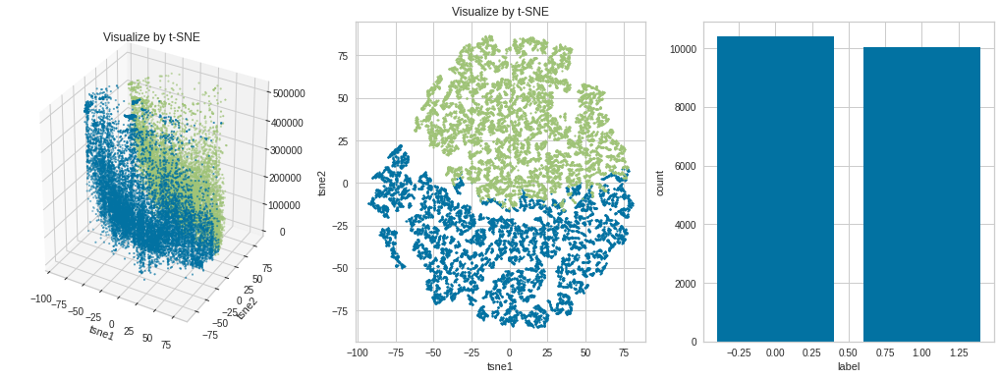




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  773.2506441927096
Count labels:  2
Silhouette score:  0.4554699975357798


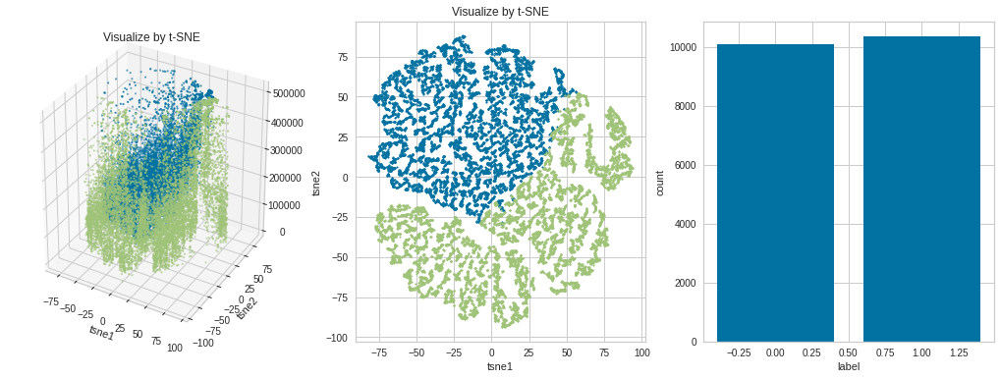




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  MinMaxScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  4
Best params :  {'random_state': 2}
inertia:  3013.2314840838008
Count labels:  4
Silhouette score:  0.5803328212074321


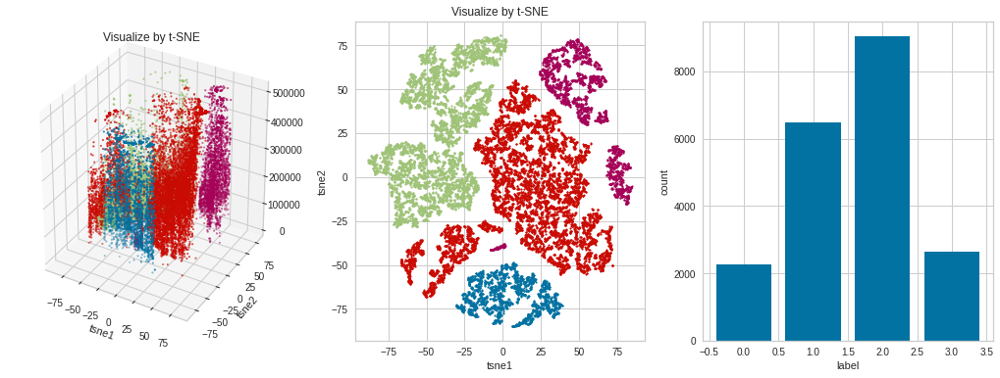




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  619.9624142359013
Count labels:  4
Silhouette score:  0.33685873057211907


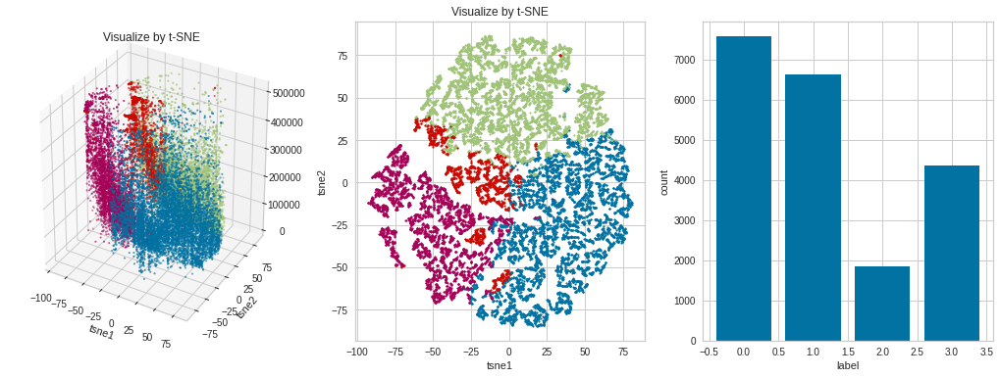




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  468.0172471264865
Count labels:  4
Silhouette score:  0.3802654258905863


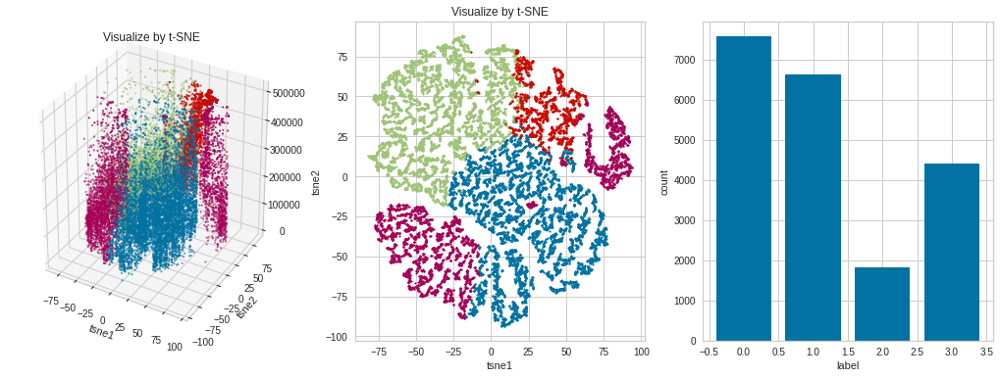




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  MinMaxScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  6
Best params :  {'random_state': 2}
inertia:  2159.53787942253
Count labels:  6
Silhouette score:  0.4625346577181734


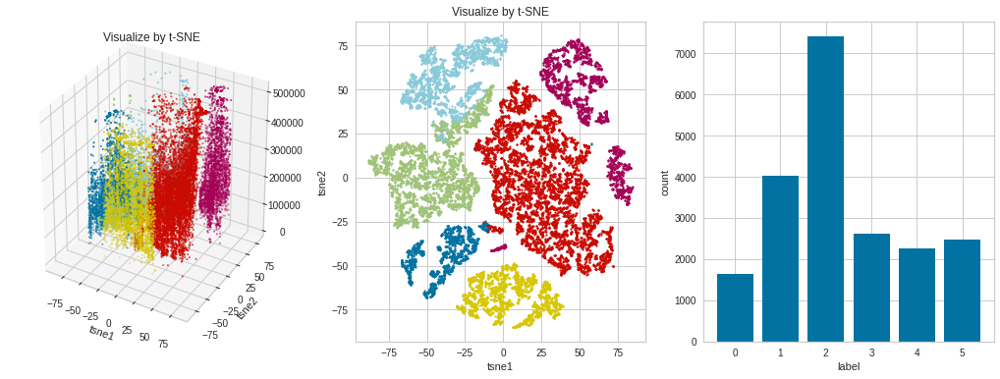




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  461.93285747324103
Count labels:  6
Silhouette score:  0.3005168194278665


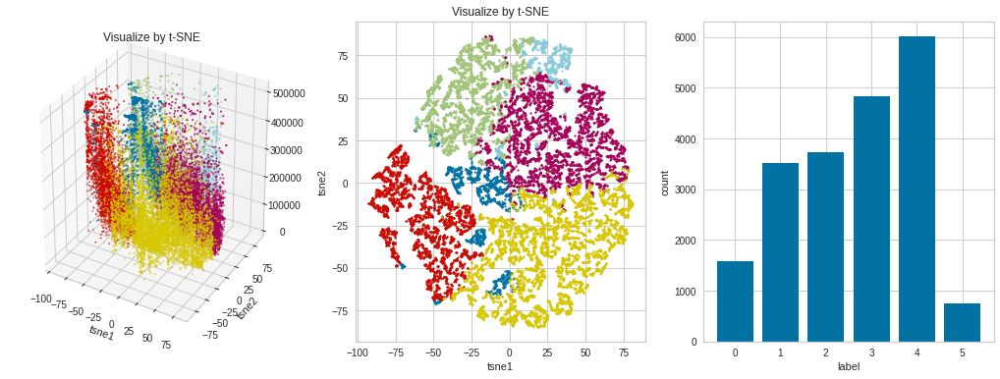




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  341.38649812116233
Count labels:  6
Silhouette score:  0.34766906403665676


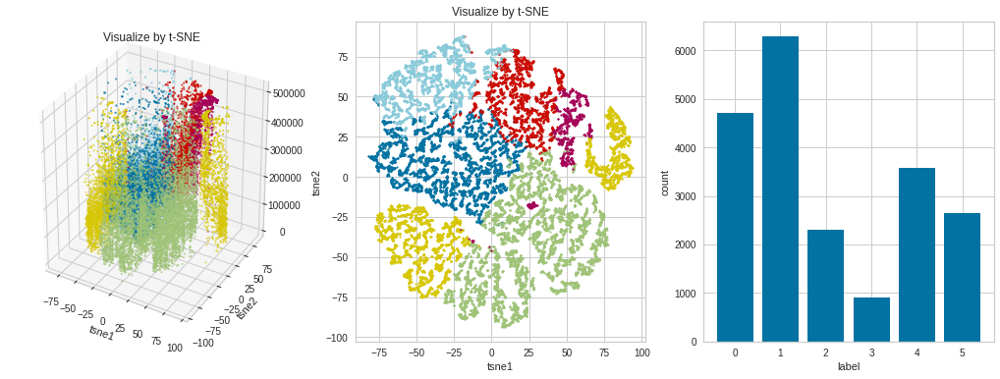




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  MinMaxScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  8
Best params :  {'random_state': 2}
inertia:  1620.7306575263106
Count labels:  8
Silhouette score:  0.4346634657759891


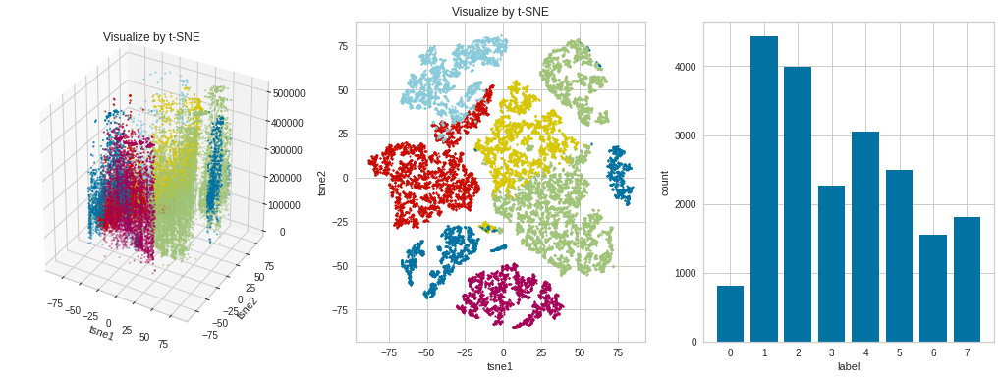




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  378.0809650956913
Count labels:  8
Silhouette score:  0.2825956338378383


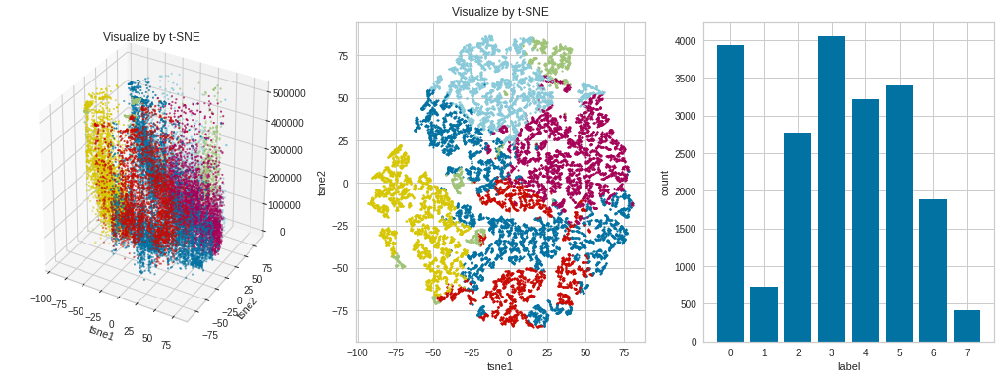




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  269.98739210703775
Count labels:  8
Silhouette score:  0.32162247450988757


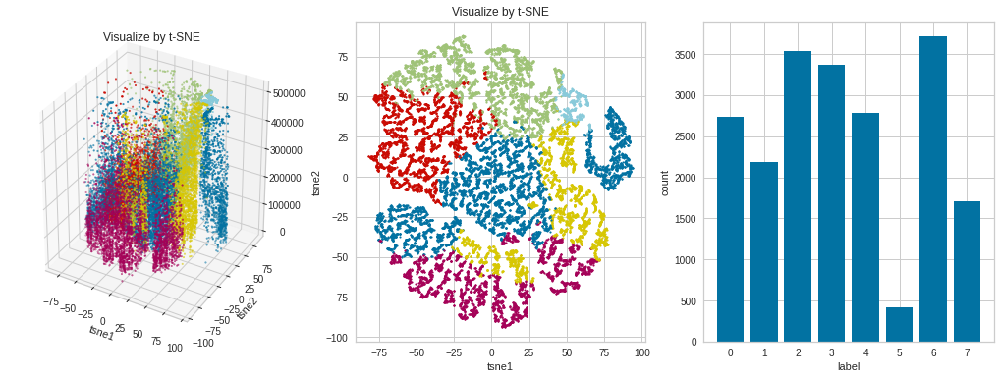




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  MinMaxScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  10
Best params :  {'random_state': 2}
inertia:  1342.5688936572942
Count labels:  10
Silhouette score:  0.39908302395481715


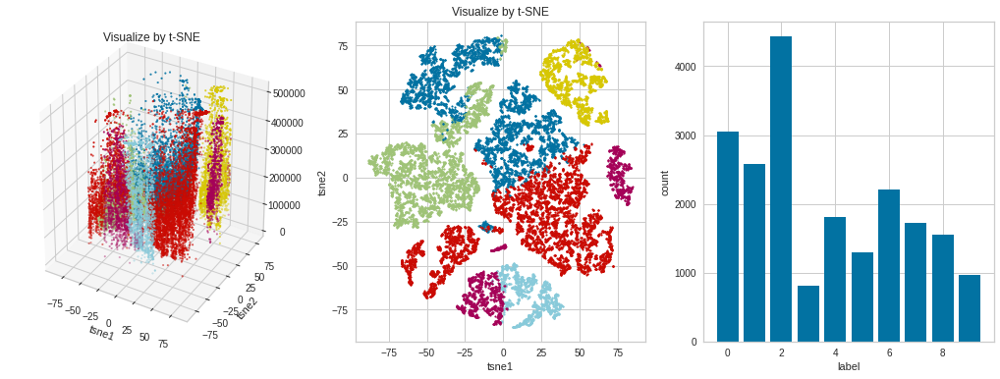




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  322.03879519443046
Count labels:  10
Silhouette score:  0.2847342610695397


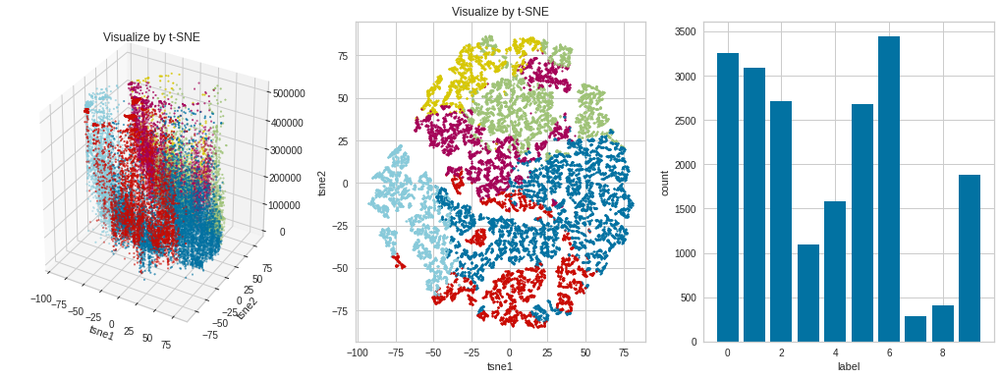




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  230.25360739299038
Count labels:  10
Silhouette score:  0.3188808202417455


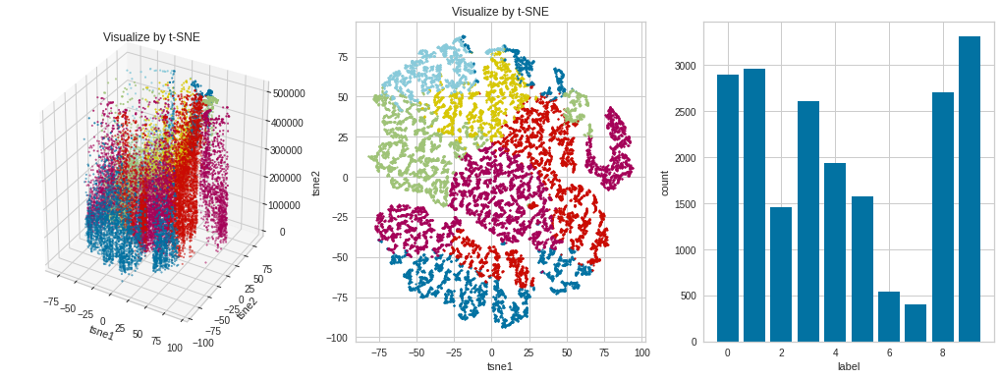




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  RobustScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  104950.00618487598
Count labels:  2
Silhouette score:  0.5433672310018803


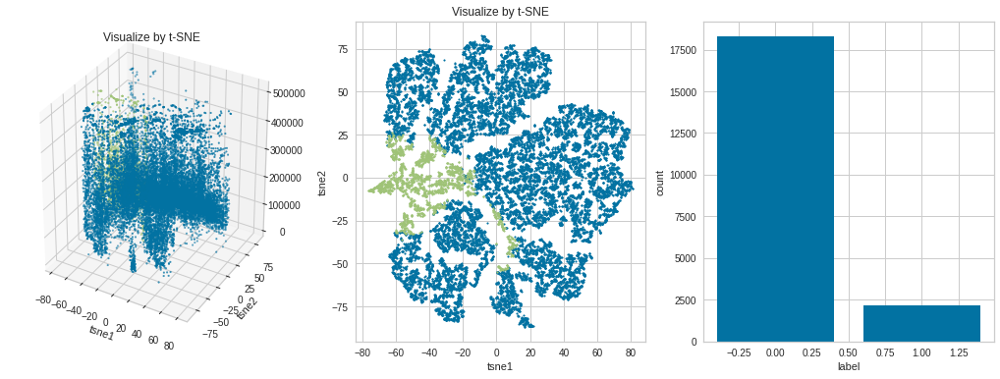




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  2
Best params :  {'random_state': 2}
inertia:  67163.88647010889
Count labels:  2
Silhouette score:  0.6000202635823454


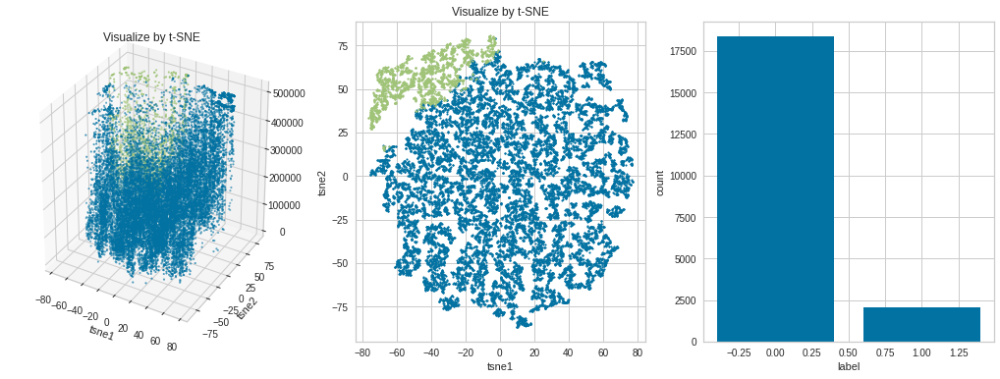




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  38957.15147267548
Count labels:  2
Silhouette score:  0.5305151704025184


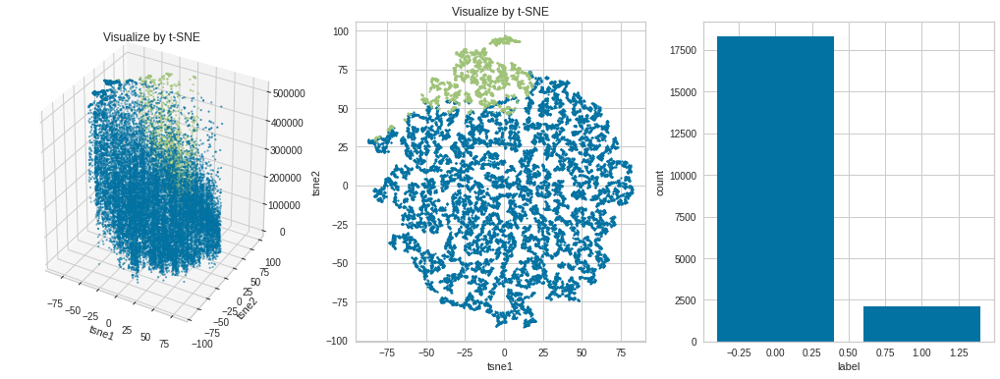




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  RobustScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  70280.91496209477
Count labels:  4
Silhouette score:  0.2370164009594768


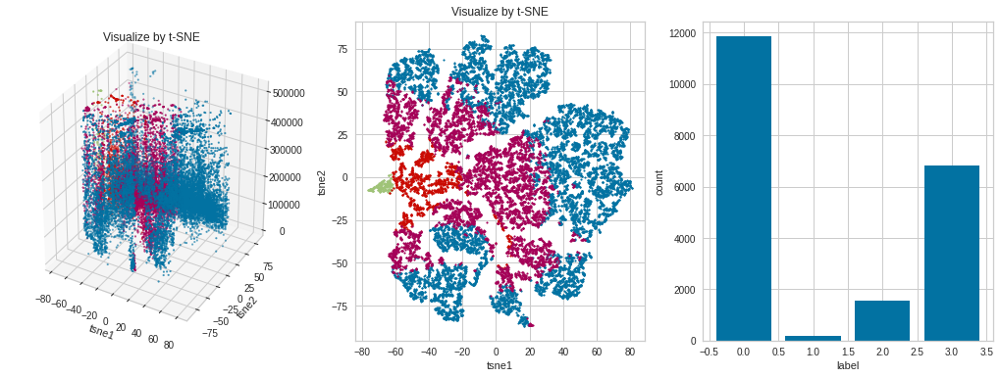




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  4
Best params :  {'random_state': 2}
inertia:  40315.81255731081
Count labels:  4
Silhouette score:  0.31223409473920877


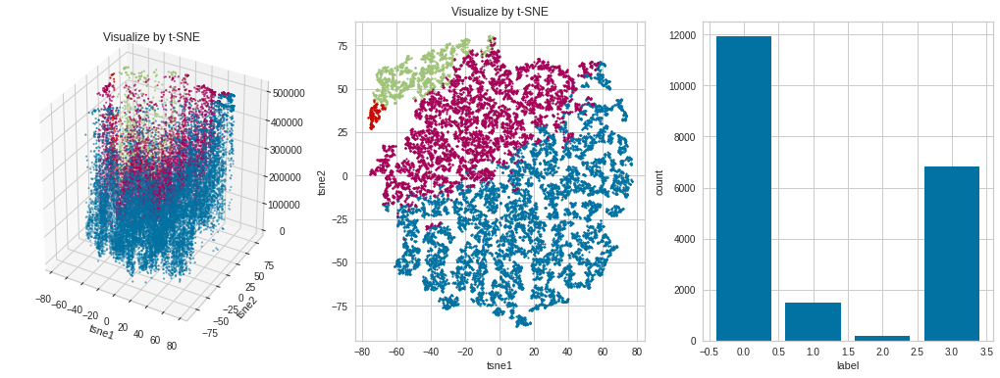




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  23824.322292396886
Count labels:  4
Silhouette score:  0.3427475968731516


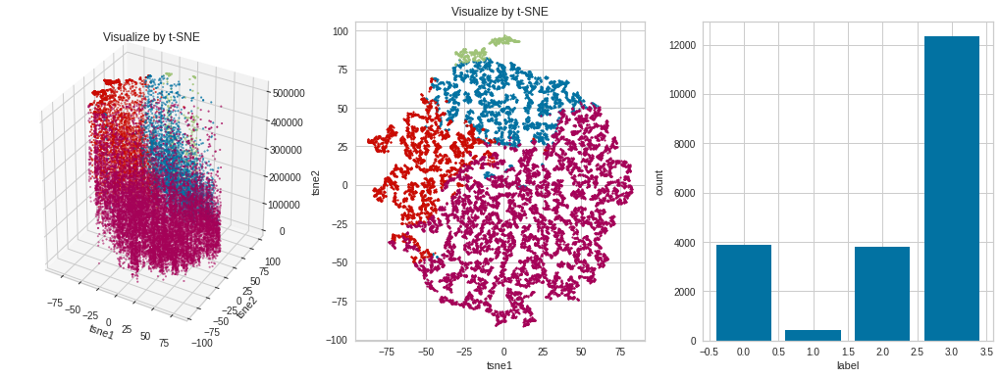




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  RobustScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  57024.17054241293
Count labels:  6
Silhouette score:  0.20607412589276086


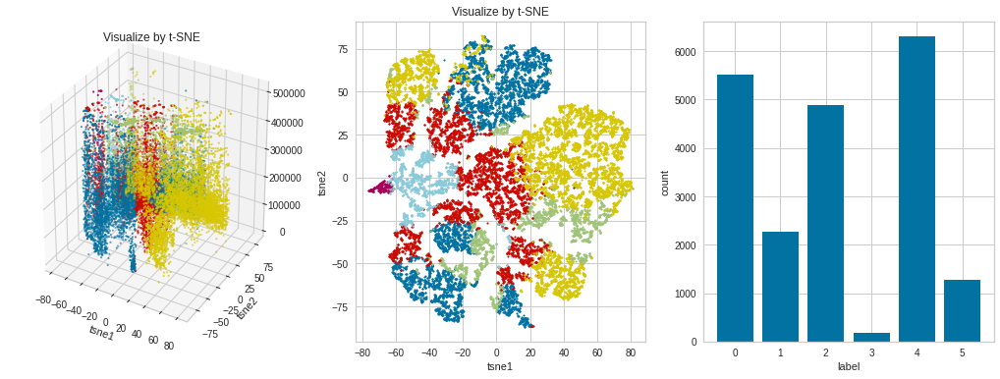




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  6
Best params :  {'random_state': 2}
inertia:  29387.62481139281
Count labels:  6
Silhouette score:  0.26824490397762435


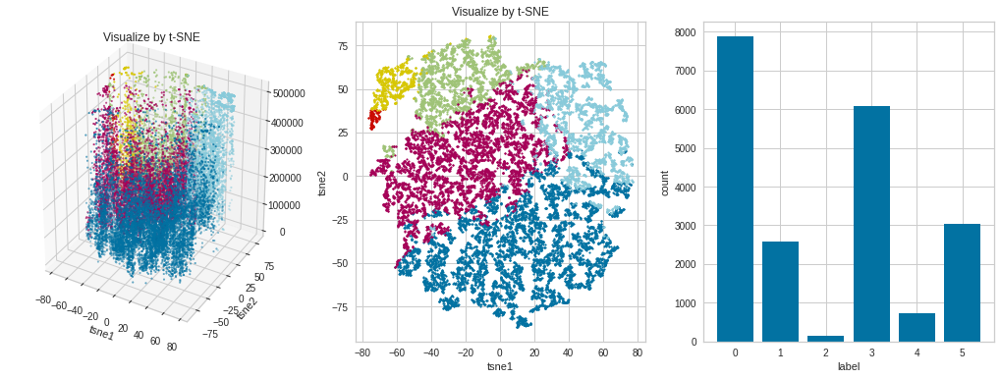




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  17446.086550505646
Count labels:  6
Silhouette score:  0.2637167507793548


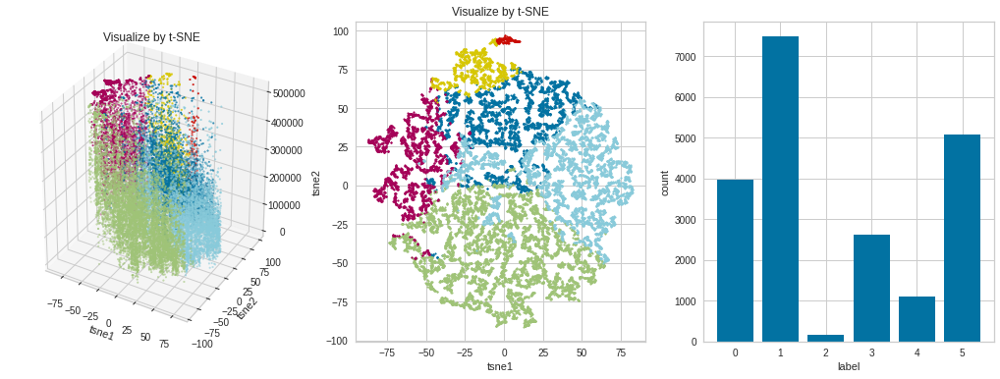




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  RobustScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  49835.67784452867
Count labels:  8
Silhouette score:  0.19035582491280975


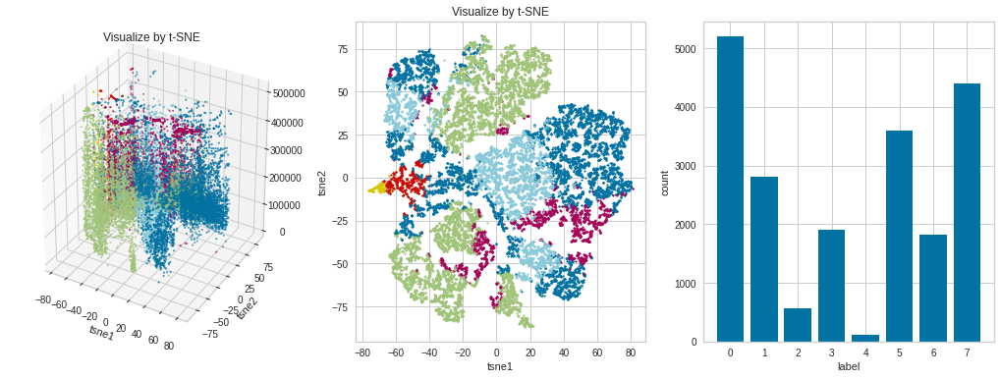




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  8
Best params :  {'random_state': 2}
inertia:  24772.327334342815
Count labels:  8
Silhouette score:  0.23727496695158615


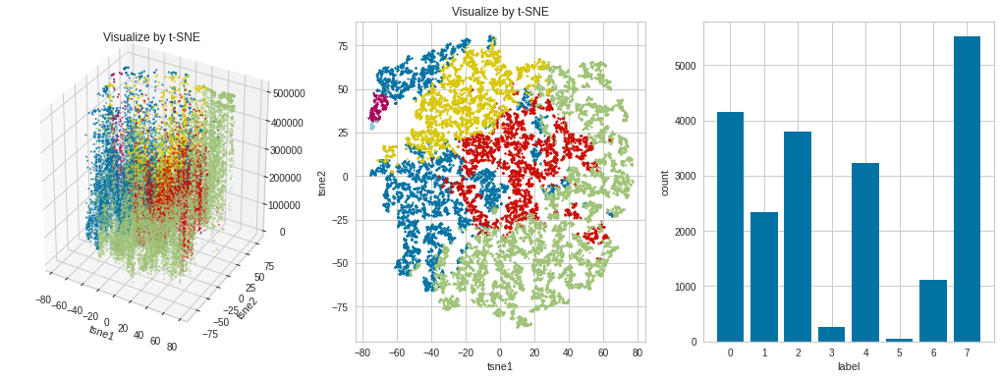




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  14066.663761913154
Count labels:  8
Silhouette score:  0.2630778593966877


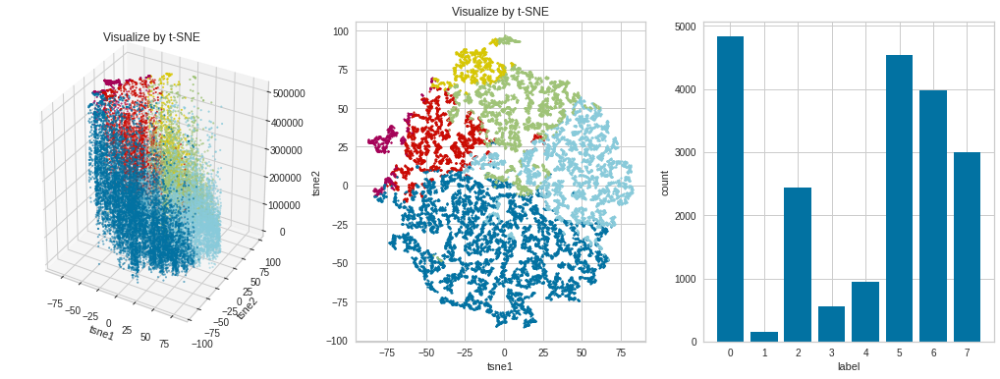




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  RobustScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  44470.90188879825
Count labels:  10
Silhouette score:  0.19576415452756848


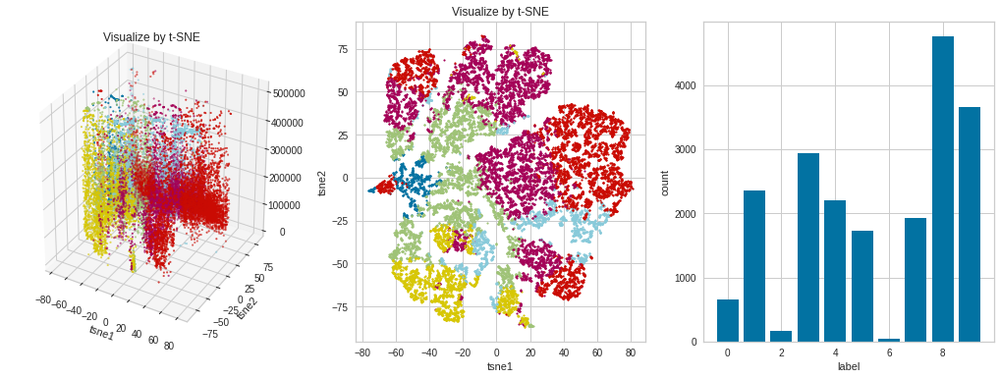




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  10
Best params :  {'random_state': 2}
inertia:  21144.11989323696
Count labels:  10
Silhouette score:  0.23285105583528667


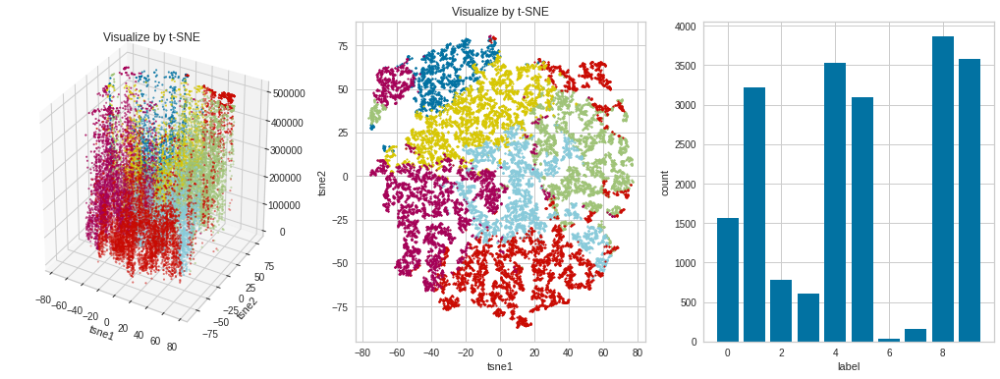




Model:  KMeans
Encoder:  OneHotEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  11983.130163991525
Count labels:  10
Silhouette score:  0.2597049096262892


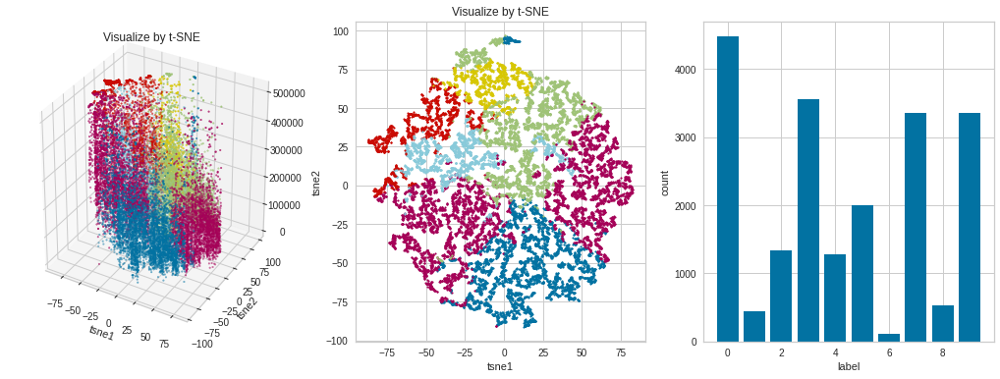




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  StandardScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  140508.2559549418
Count labels:  2
Silhouette score:  0.392694776266107


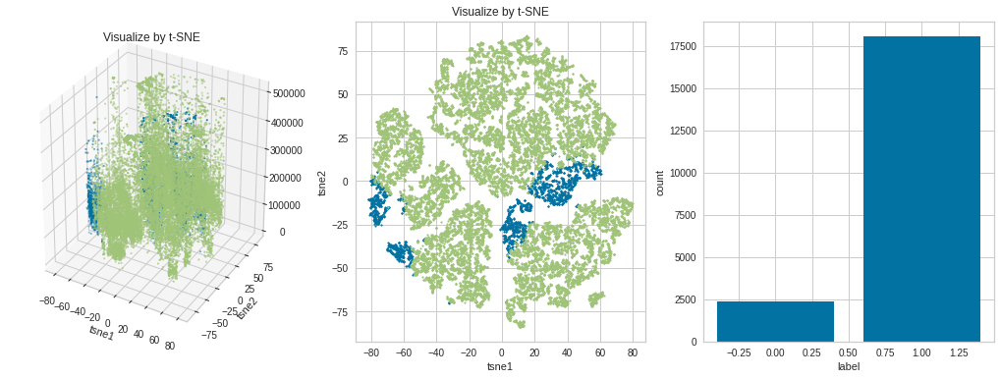




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  2
Best params :  {'random_state': 2}
inertia:  67847.22872431541
Count labels:  2
Silhouette score:  0.5063515570915781


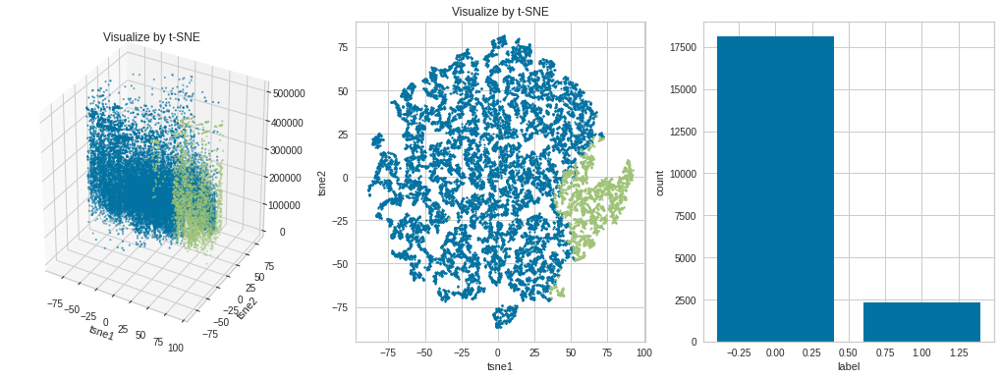




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  43170.93603437653
Count labels:  2
Silhouette score:  0.32415963974988227


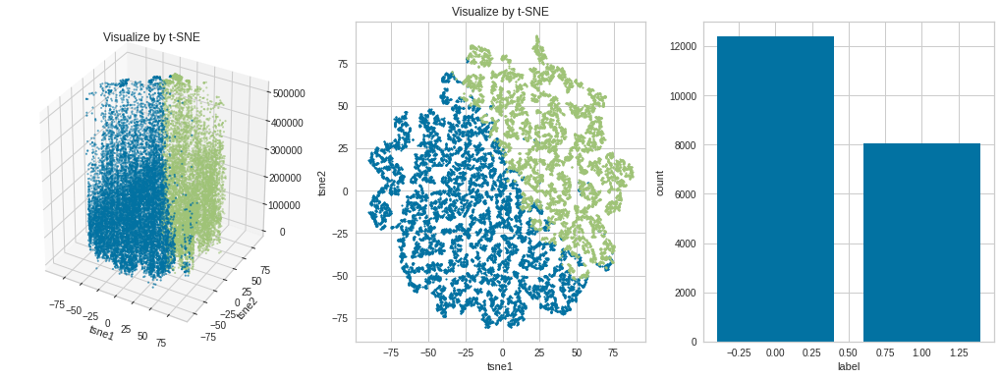




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  StandardScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  94026.57168713145
Count labels:  4
Silhouette score:  0.295065345344187


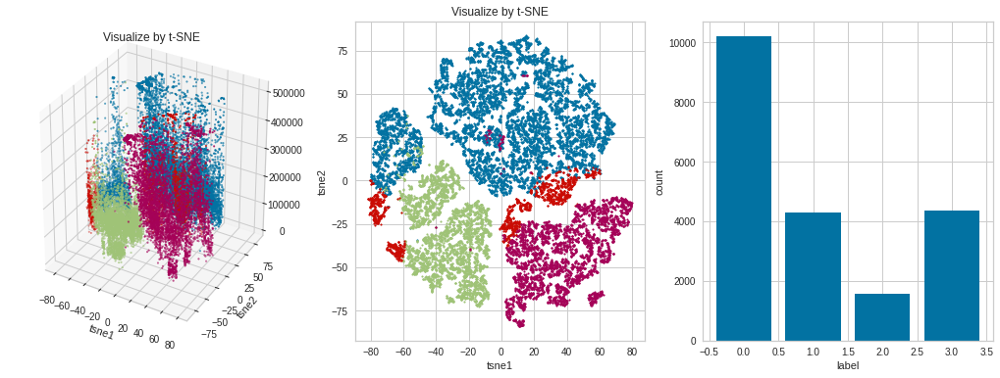




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  4
Best params :  {'random_state': 2}
inertia:  43822.61775953201
Count labels:  4
Silhouette score:  0.2997164606474733


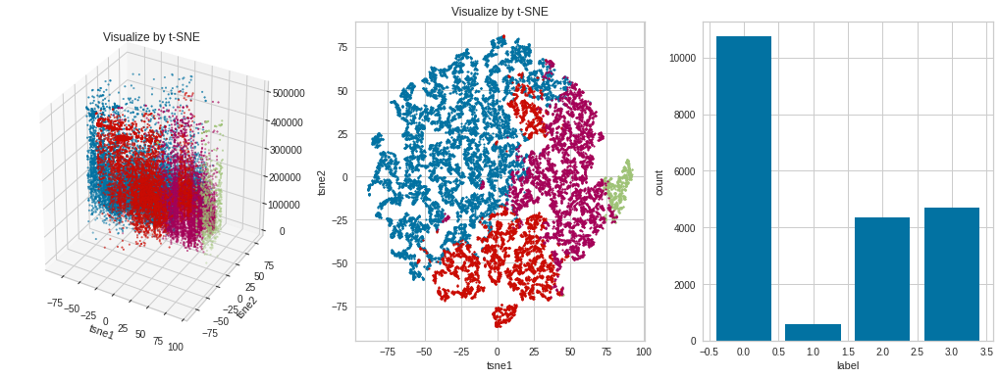




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  26094.58103072478
Count labels:  4
Silhouette score:  0.326915829666588


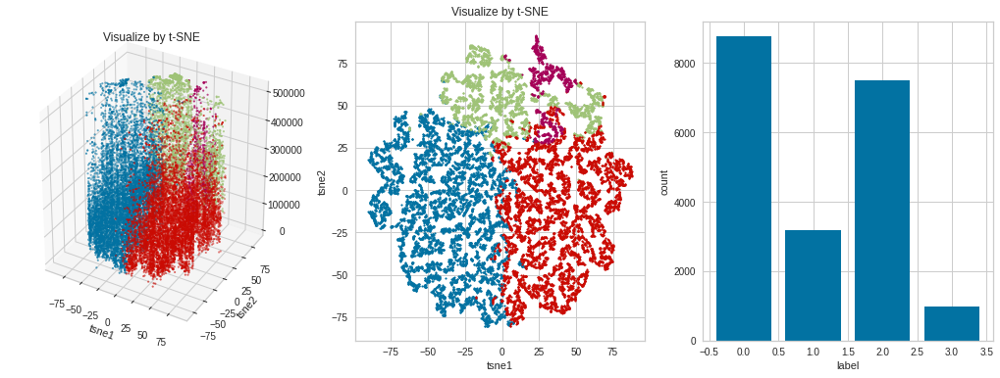




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  StandardScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  74925.39551377282
Count labels:  6
Silhouette score:  0.2489962616897381


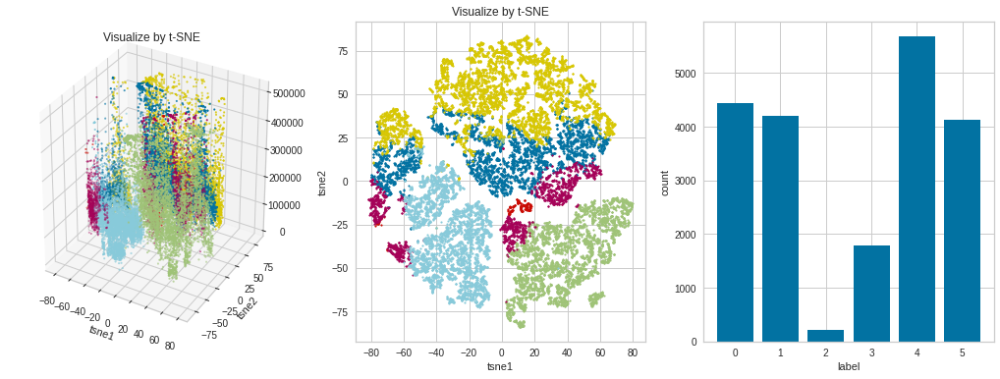




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  6
Best params :  {'random_state': 2}
inertia:  31681.66962541666
Count labels:  6
Silhouette score:  0.2755152514382991


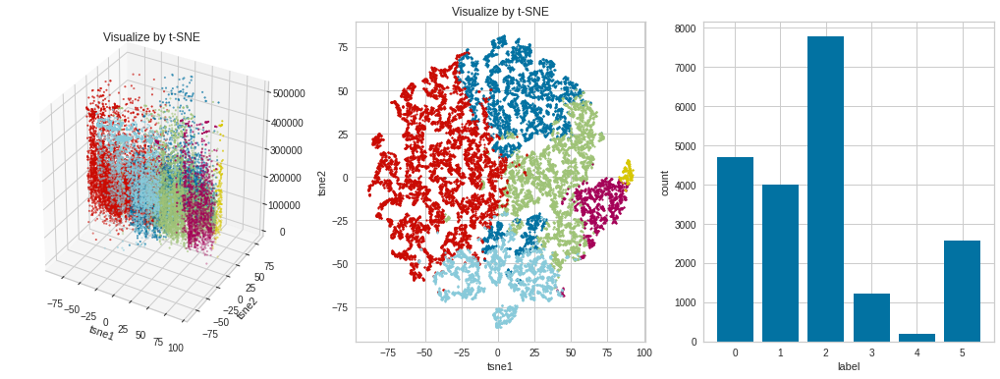




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  20089.990229716066
Count labels:  6
Silhouette score:  0.27633602688255005


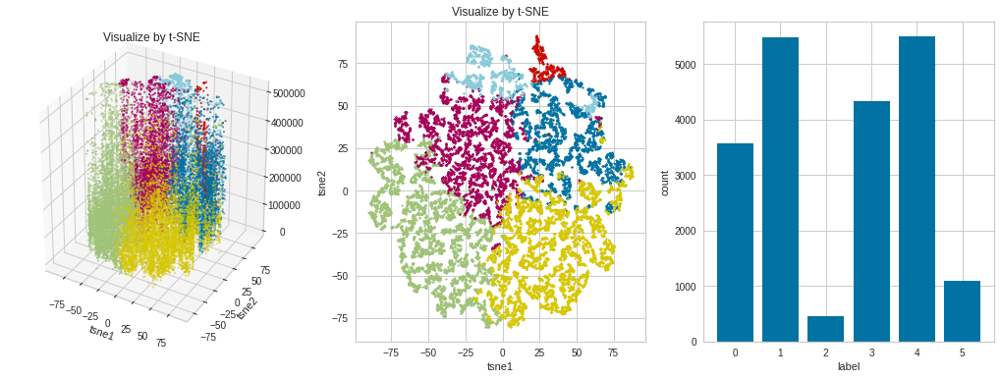




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  StandardScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  63760.34536453655
Count labels:  8
Silhouette score:  0.2596582442819428


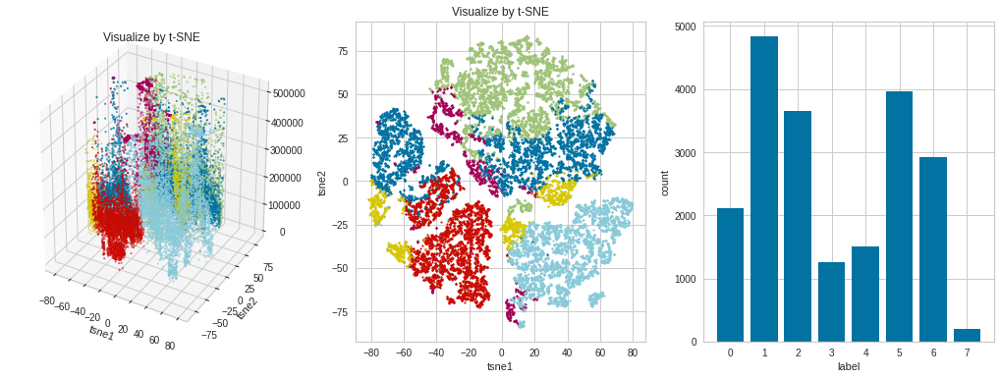




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  8
Best params :  {'random_state': 2}
inertia:  26691.694126957096
Count labels:  8
Silhouette score:  0.24810916699420546


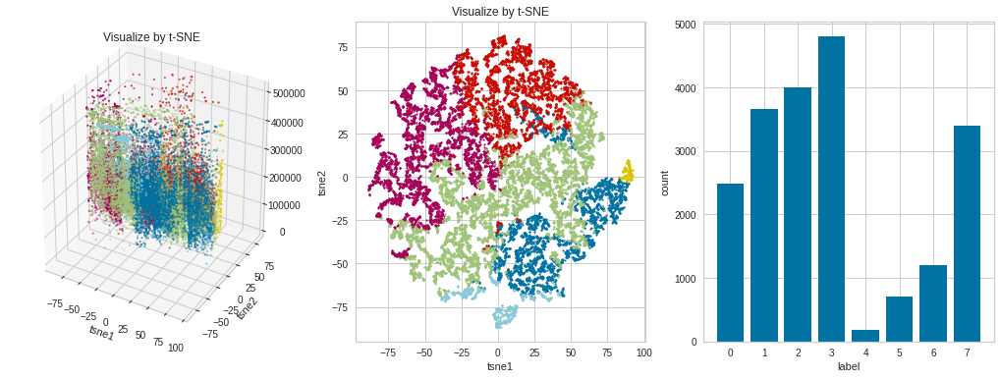




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  15830.384554433815
Count labels:  8
Silhouette score:  0.2653898371036186


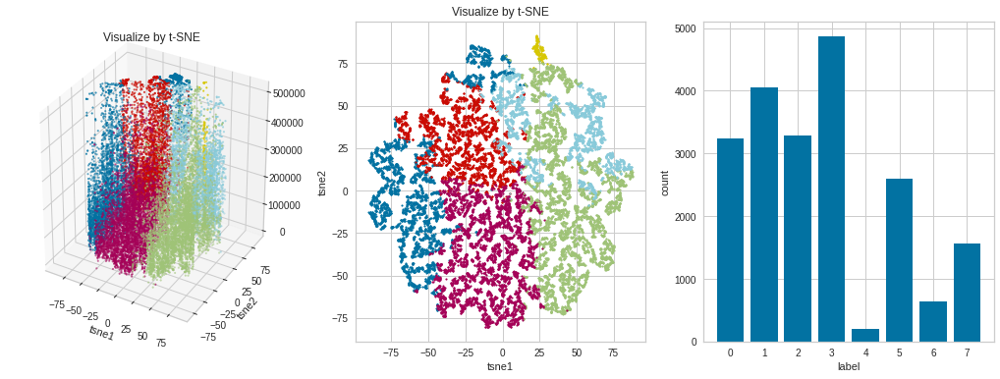




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  StandardScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  56591.31891432109
Count labels:  10
Silhouette score:  0.2463285647357728


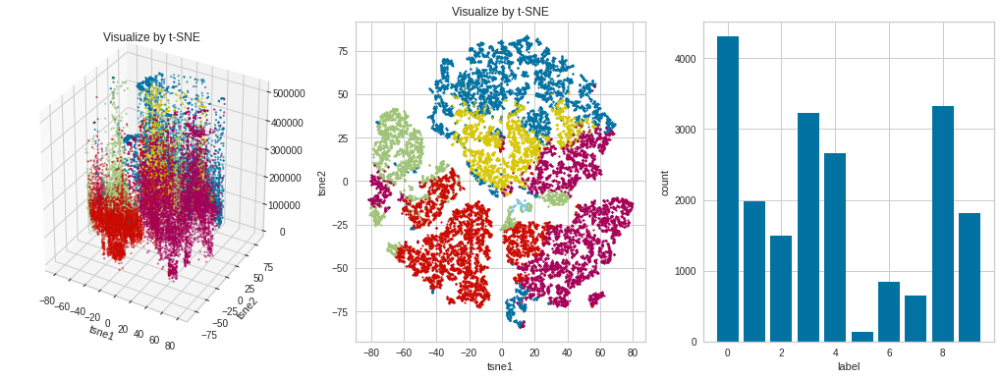




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  10
Best params :  {'random_state': 2}
inertia:  22892.90682799973
Count labels:  10
Silhouette score:  0.24288537417251432


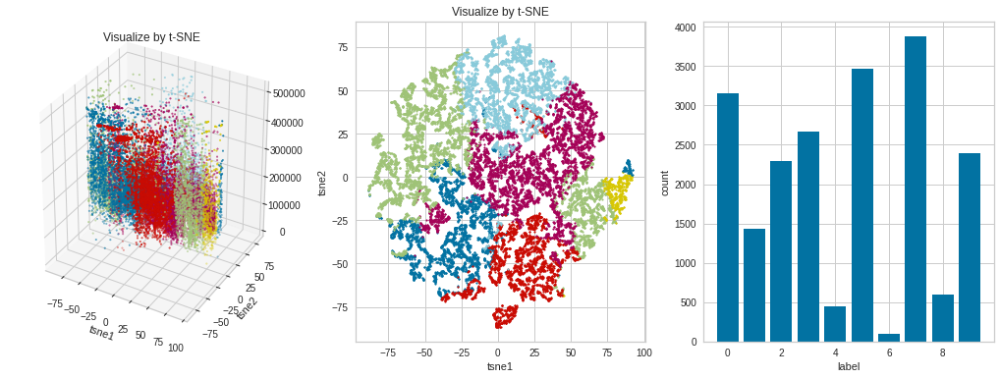




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  StandardScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  13619.213995308382
Count labels:  10
Silhouette score:  0.26437229145031965


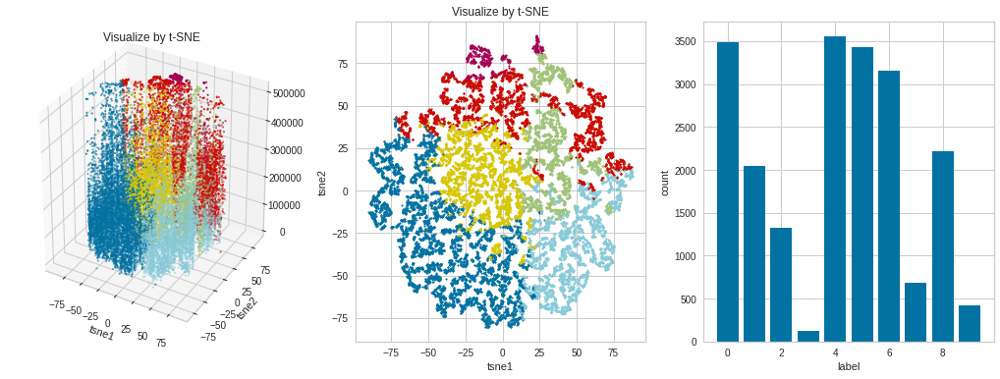




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  MinMaxScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  3088.5478832723607
Count labels:  2
Silhouette score:  0.3535166028606688


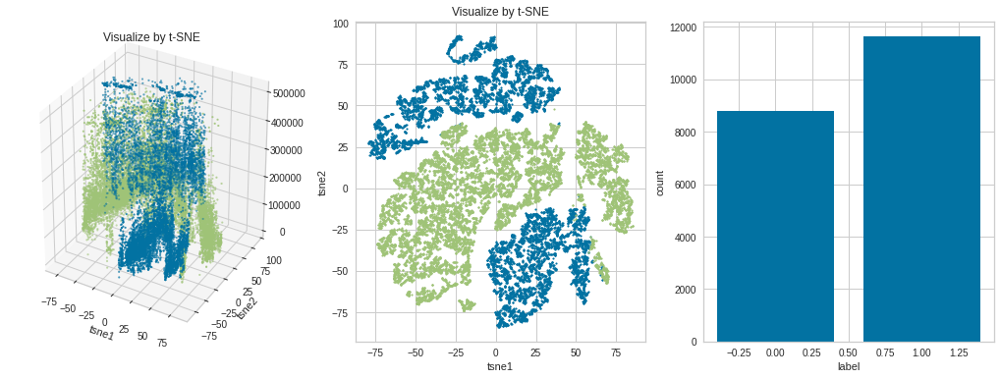




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  927.8707112859477
Count labels:  2
Silhouette score:  0.4266312746662995


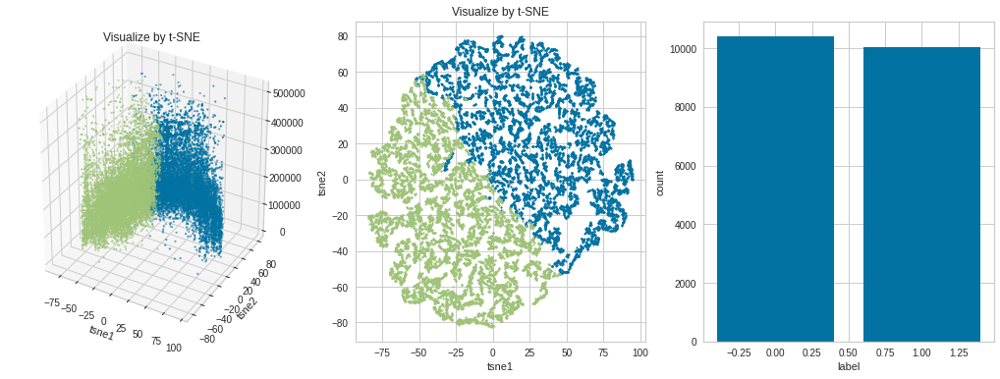




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  773.2506441927096
Count labels:  2
Silhouette score:  0.4554699975357798


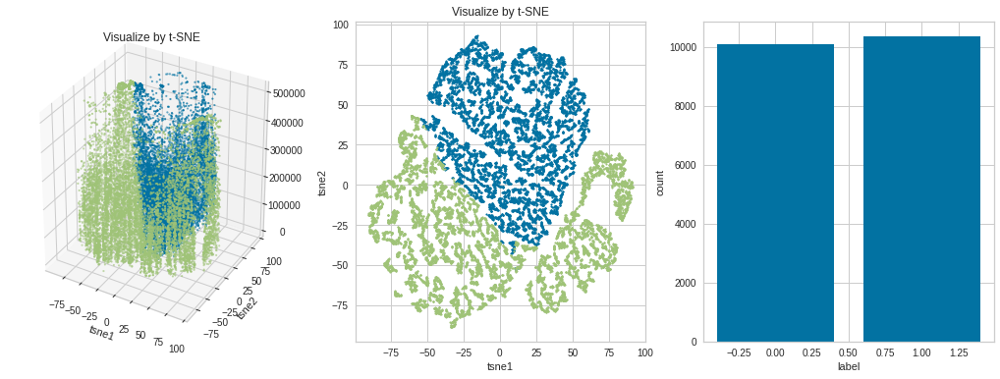




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  MinMaxScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  1920.8050644808575
Count labels:  4
Silhouette score:  0.34181031038625526


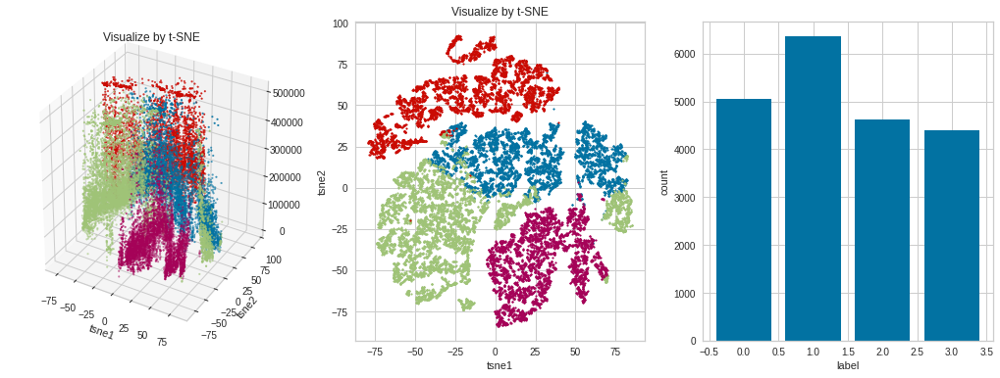




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  619.9624142359013
Count labels:  4
Silhouette score:  0.33685873057211907


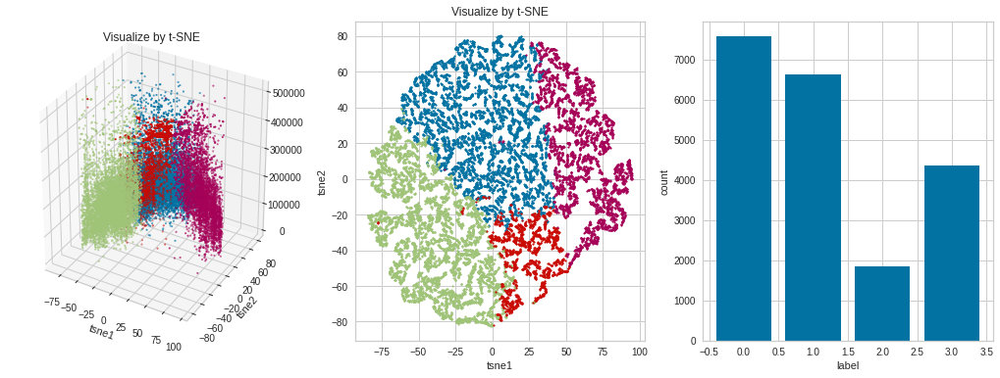




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  468.0172471264865
Count labels:  4
Silhouette score:  0.3802654258905863


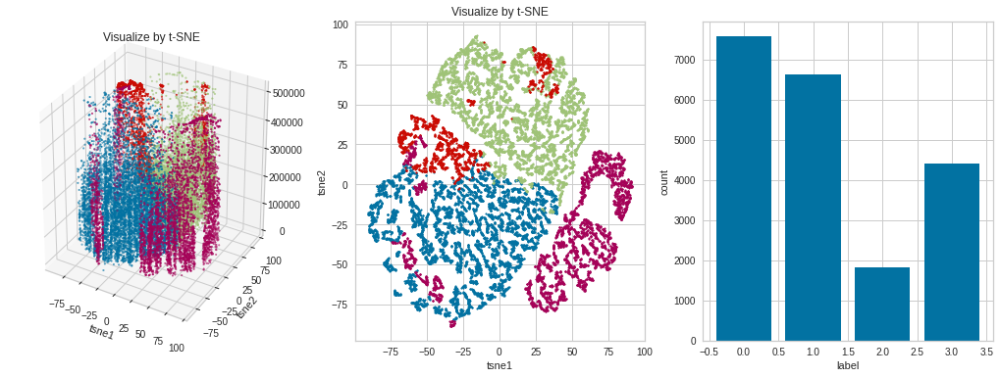




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  MinMaxScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  1388.925364638495
Count labels:  6
Silhouette score:  0.3539694051078815


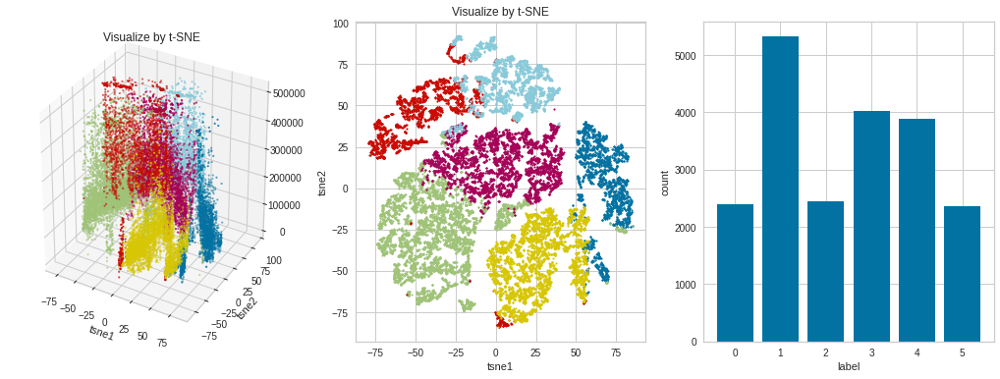




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  461.93285747324103
Count labels:  6
Silhouette score:  0.3005168194278665


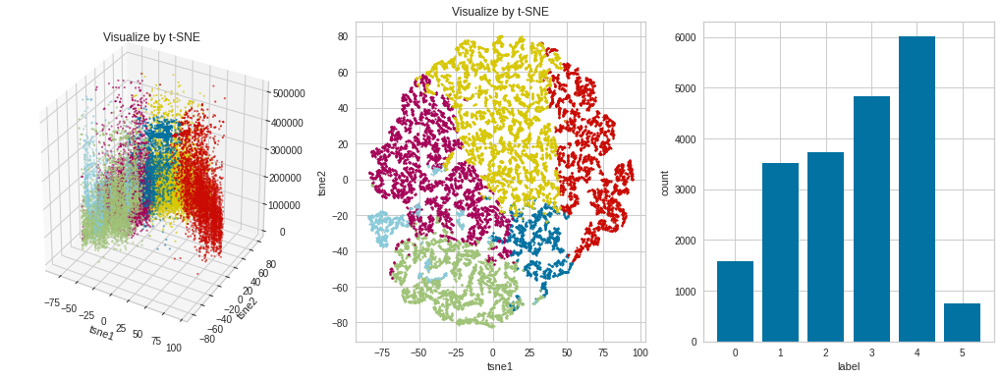




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  341.38649812116233
Count labels:  6
Silhouette score:  0.34766906403665676


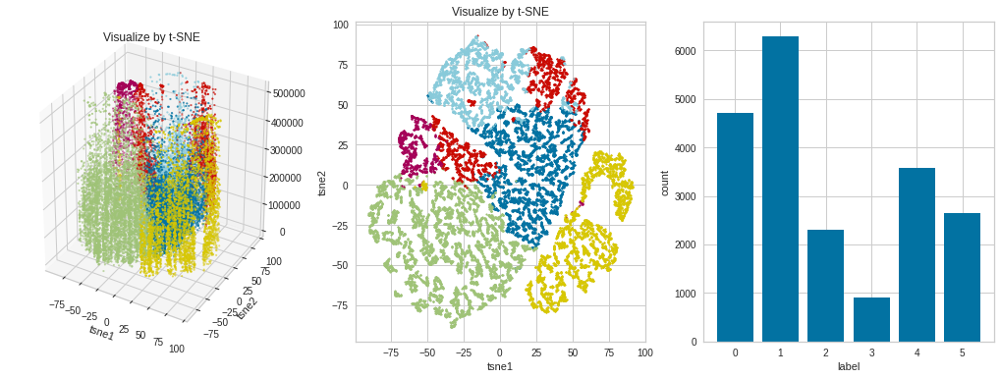




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  MinMaxScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  1121.7255519681726
Count labels:  8
Silhouette score:  0.3602929930605609


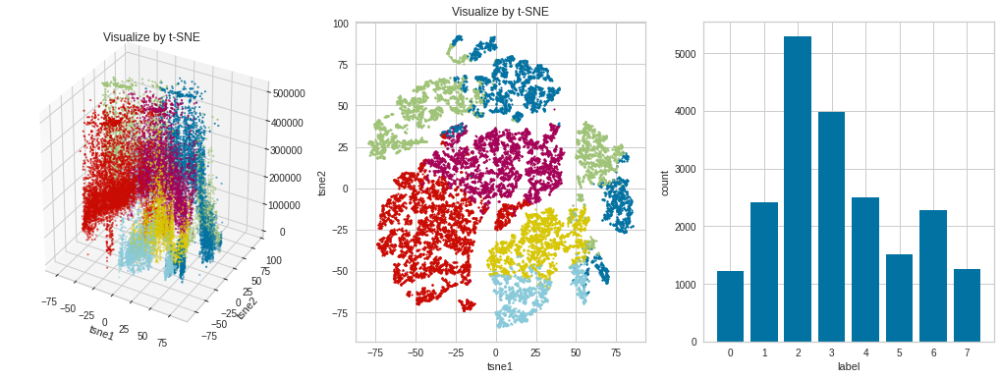




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  378.0809650956913
Count labels:  8
Silhouette score:  0.2825956338378383


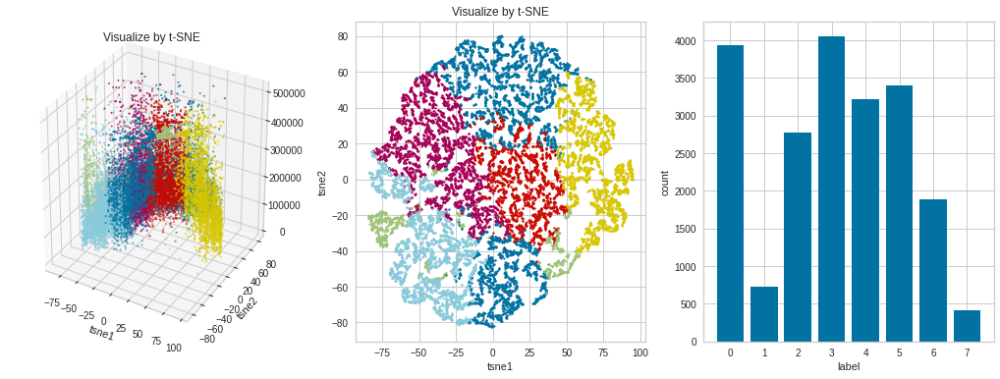




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  269.98739210703775
Count labels:  8
Silhouette score:  0.32162247450988757


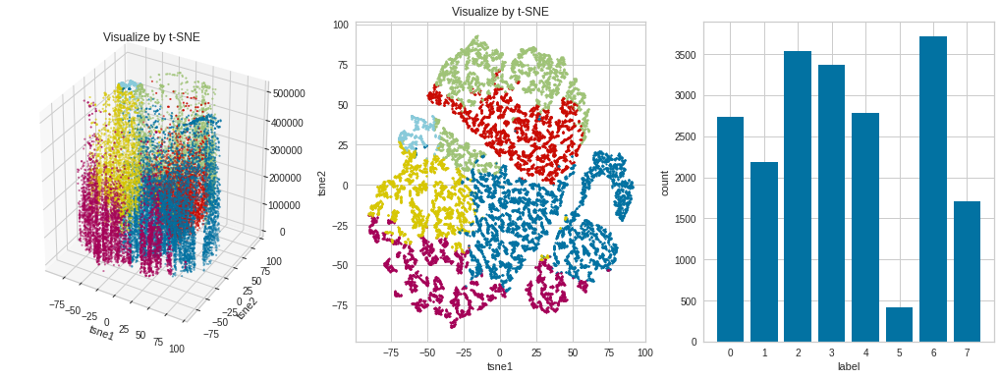




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  MinMaxScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  988.9694541637962
Count labels:  10
Silhouette score:  0.3142750443397852


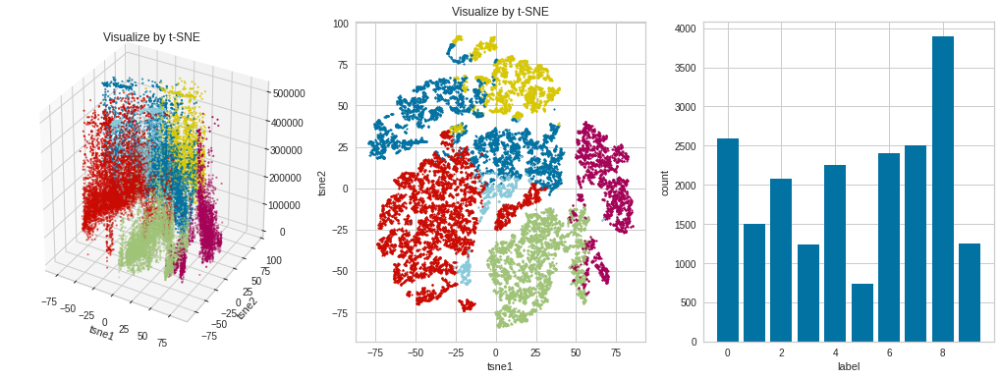




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  322.03879519443046
Count labels:  10
Silhouette score:  0.2847342610695397


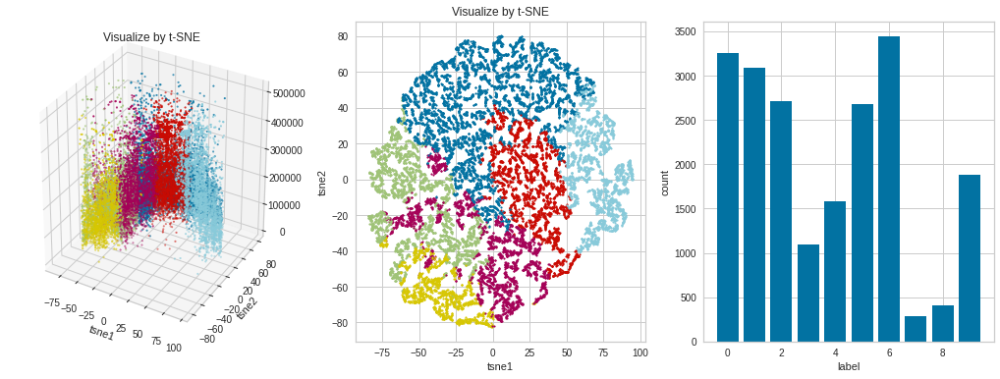




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  MinMaxScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  230.25360739299038
Count labels:  10
Silhouette score:  0.3188808202417455


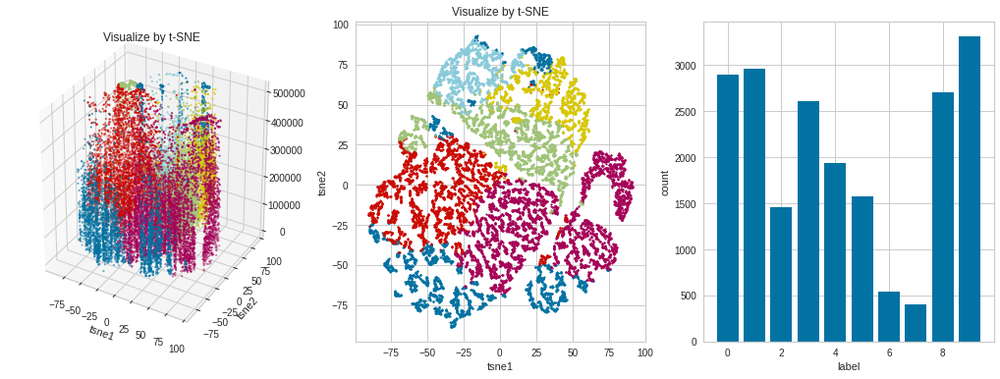




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  RobustScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  101074.8055549499
Count labels:  2
Silhouette score:  0.5528789838801997


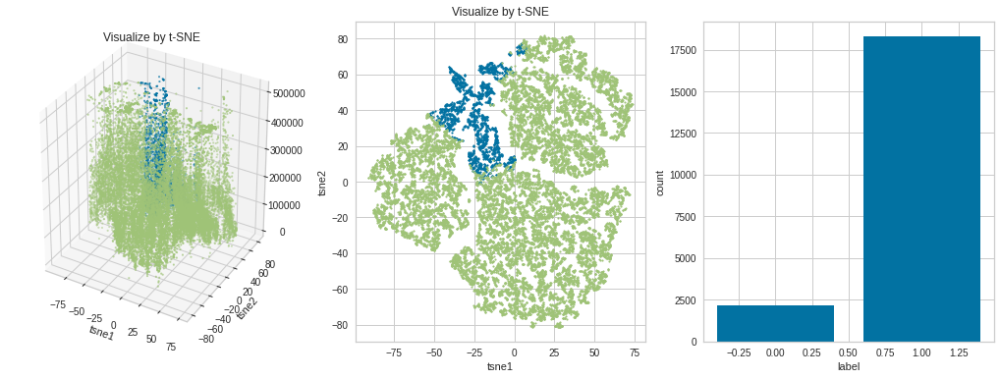




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  2
Best params :  {'random_state': 2}
inertia:  67163.88647010889
Count labels:  2
Silhouette score:  0.6000202635823454


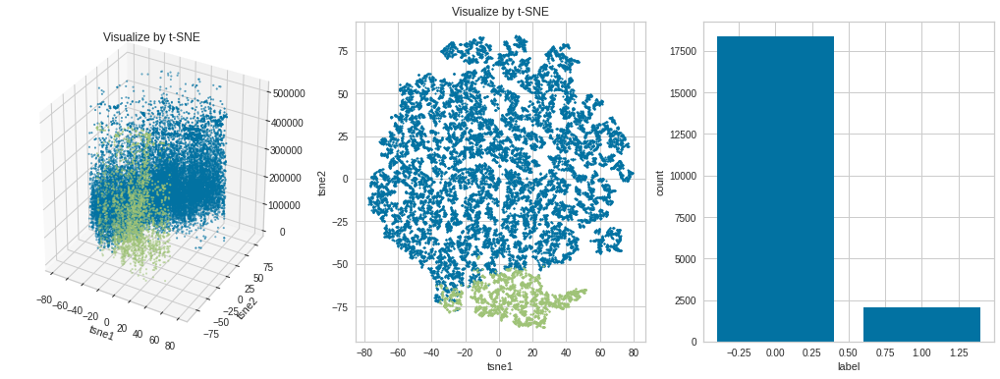




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  2
Best params :  {'random_state': 1}
inertia:  38957.15147267548
Count labels:  2
Silhouette score:  0.5305151704025184


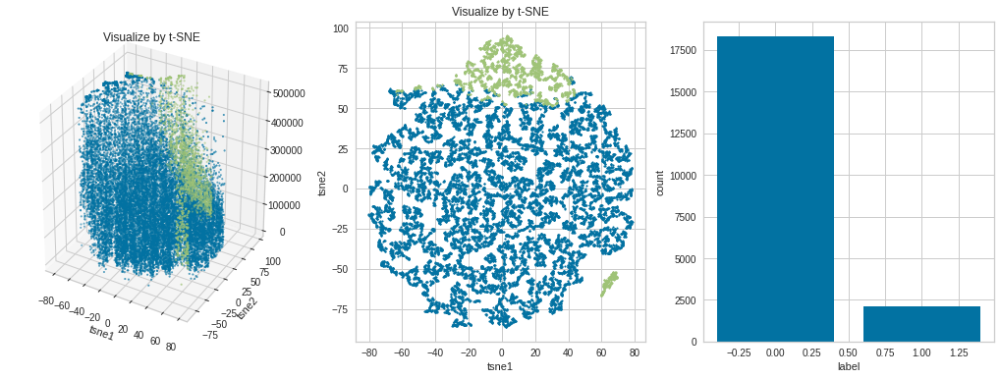




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  RobustScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  66412.97535401744
Count labels:  4
Silhouette score:  0.24815658817270161


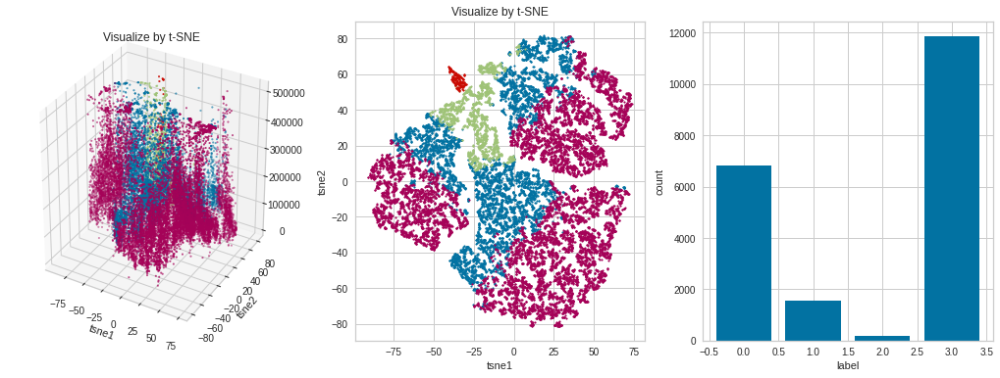




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  4
Best params :  {'random_state': 2}
inertia:  40315.81255731081
Count labels:  4
Silhouette score:  0.31223409473920877


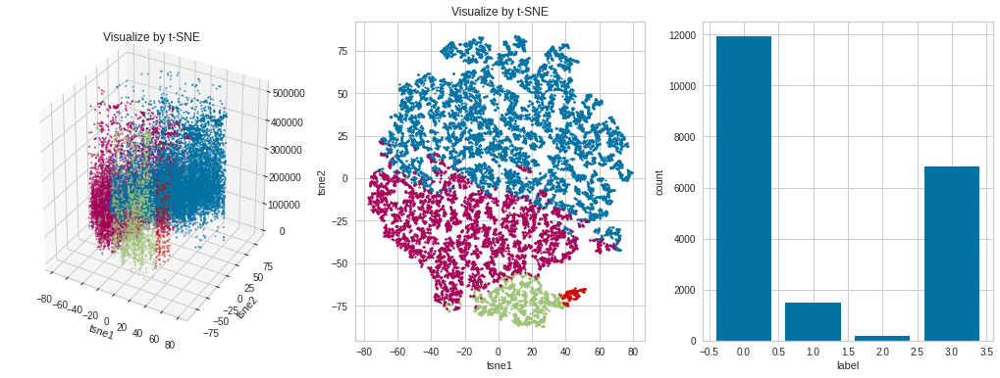




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  4
Best params :  {'random_state': 1}
inertia:  23824.322292396886
Count labels:  4
Silhouette score:  0.3427475968731516


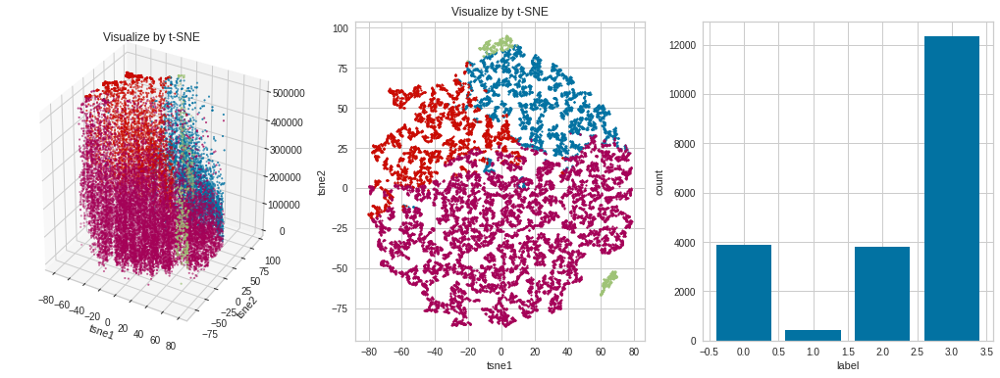




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  RobustScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  53420.031395113794
Count labels:  6
Silhouette score:  0.21560151484811957


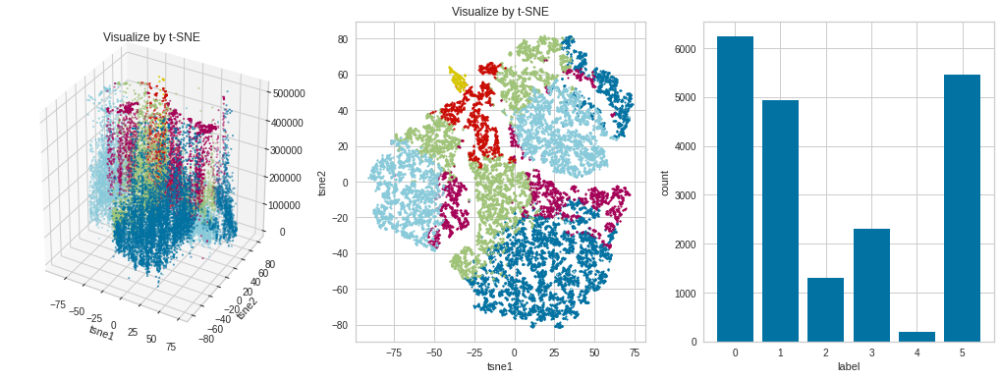




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  6
Best params :  {'random_state': 2}
inertia:  29387.62481139281
Count labels:  6
Silhouette score:  0.26824490397762435


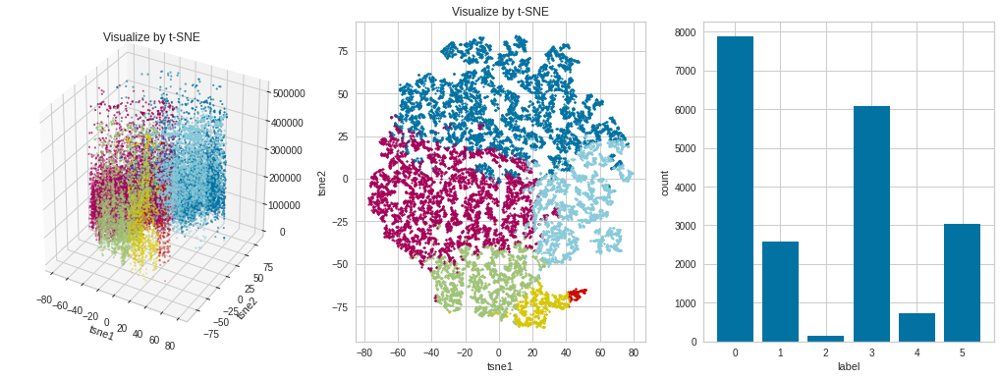




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  6
Best params :  {'random_state': 1}
inertia:  17446.086550505646
Count labels:  6
Silhouette score:  0.2637167507793548


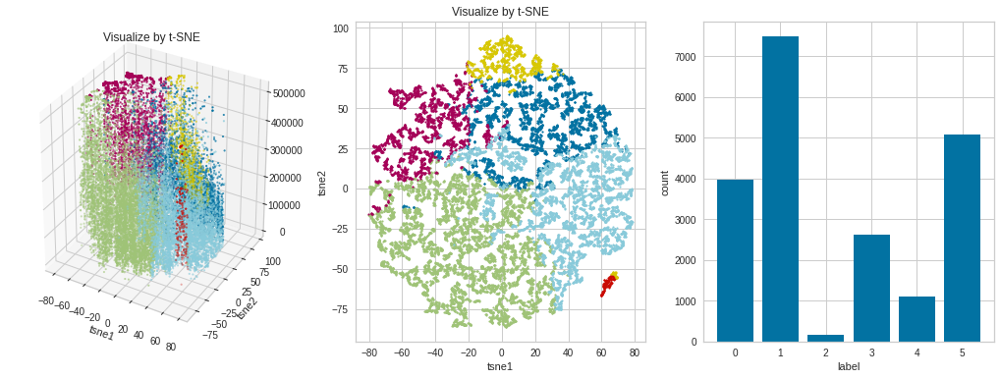




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  RobustScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  46303.70494409236
Count labels:  8
Silhouette score:  0.20095577179008944


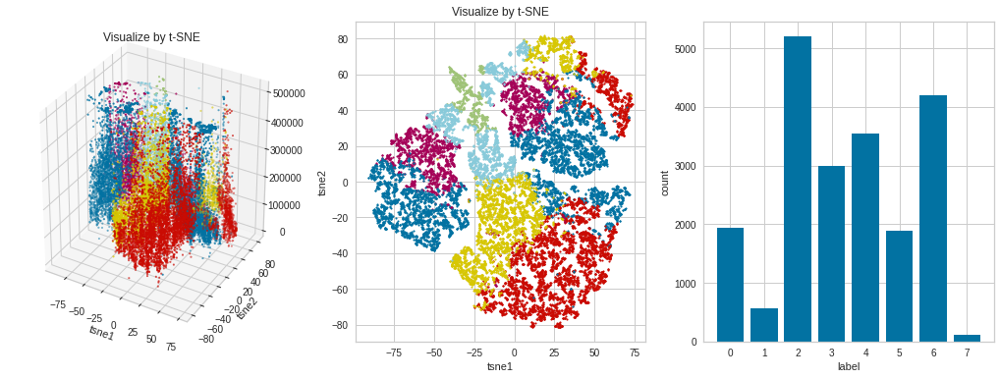




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  8
Best params :  {'random_state': 2}
inertia:  24772.327334342815
Count labels:  8
Silhouette score:  0.23727496695158615


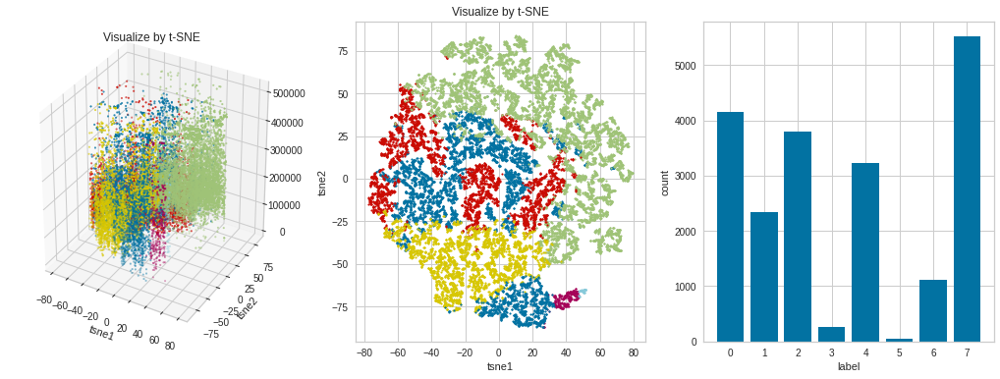




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  8
Best params :  {'random_state': 1}
inertia:  14066.663761913154
Count labels:  8
Silhouette score:  0.2630778593966877


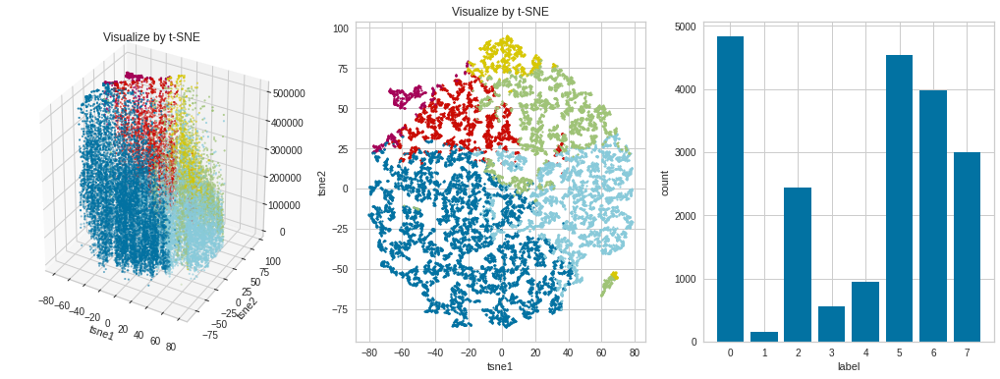




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  RobustScaler
Feature list:  ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  41172.313994461874
Count labels:  10
Silhouette score:  0.20360641553925707


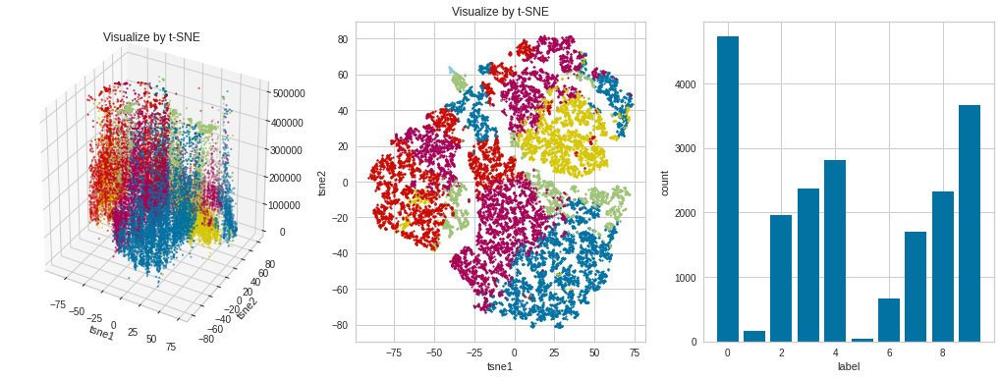




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms']
n_cluster:  10
Best params :  {'random_state': 2}
inertia:  21144.11989323696
Count labels:  10
Silhouette score:  0.23285105583528667


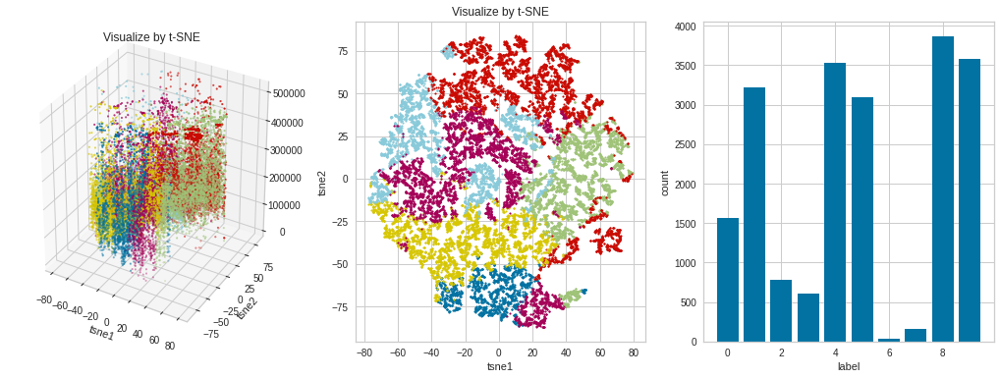




Model:  KMeans
Encoder:  TargetEncoder
Scaler:  RobustScaler
Feature list:  ['median_income', 'total_rooms', 'housing_median_age']
n_cluster:  10
Best params :  {'random_state': 1}
inertia:  11983.130163991525
Count labels:  10
Silhouette score:  0.2597049096262892


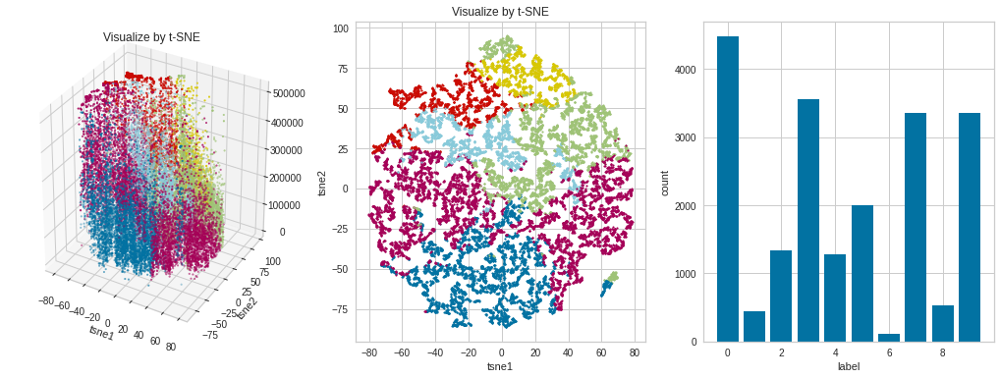

In [ ]:
model_list = ['KMeans'] 
encoder_list = ['LabelEncoder', 'OneHotEncoder', 'TargetEncoder'] 
scaler_list = ['StandardScaler', 'MinMaxScaler', 'RobustScaler'] 
n_clusters = [2, 4, 6, 8, 10] 

feature_combinations = [ ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'ocean_proximity'], 
['median_income', 'total_rooms', 'housing_median_age', 'households', 'total_bedrooms'],
['median_income', 'total_rooms', 'housing_median_age']] 
hyper_parameter_dict = {
    'KMeans' : {'random_state' : [1, 2]},
    'DBSCAN' : {'eps':[0.5, 0.7, 0.9, 1.1, 1.3], 'min_samples':[3, 4, 6]},
    'EM':{'n_components':[2, 4, 6, 8, 10],'random_state':[1,2]},
    'CLARANS' : {'numlocal' : [6, 8, 10], 'maxneighbor' : [4, 6]}
}

AutoML(data, model_list, encoder_list, scaler_list, n_clusters, feature_combinations, hyper_parameter_dict, silhouette_score)